## Content:
- [Introduction](#introduction)
    * [Problem Statement](#problem-statement)
- [The Data](#the-data)
- [Analysis](#analysis)

# Introduction<a class="anchor" id="introduction"></a>
The Carbon Disclosure Project (CDP) is a global non-profit that drives companies and governments to reduce their greenhouse gas emissions, safeguard water resources, and protect forests. Each year, CDP takes the information supplied in its annual reporting process and scores companies and cities based on their journey through disclosure and towards environmental leadership.

### Problem Statement <a class="anchor" id="problem-statement"></a>
Develop a methodology for calculating key performance indicators (KPIs) that relate to the environmental and social issues that are discussed in the CDP survey data. Leverage external data sources and thoroughly discuss the intersection between environmental issues and social issues. Mine information to create automated insight generation demonstrating whether city and corporate ambitions take these factors into account.

City and corporate ambitions account for enironmental and social issues?

## Brainstorming

In [ ]:
Analyze Cities
-populations vs gdp
-carbon emmissions
-water pollution
-waste management
-immigration
-city area vs above statistcs

kpi ideas:
    -PCA
    -Cluster - Kmeans
    
Does response tackle issues?

Analyze Corporations
-carbon emmissions
-water pollutions
-water management

## The Data<a class="anchor" id="the-data"></a>

In [230]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', -1)
import re
import matplotlib.pyplot as plt

from kmodes.kmodes import KModes
from sklearn import preprocessing
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from kneed import KneeLocator

import warnings
warnings.filterwarnings('ignore')

In [2]:
cities18 = pd.read_csv('../data/Cities/Cities Disclosing/2018_Cities_Disclosing_to_CDP.csv')
cities19 = pd.read_csv('../data/Cities/Cities Disclosing/2019_Cities_Disclosing_to_CDP.csv')
cities20 = pd.read_csv('../data/Cities/Cities Disclosing/2020_Cities_Disclosing_to_CDP.csv')
citiesall = pd.concat([cities18,cities19, cities20])

resp18 = pd.read_csv('../data/Cities/Cities Responses/2018_Full_Cities_Dataset.csv')
resp19 = pd.read_csv('../data/Cities/Cities Responses/2019_Full_Cities_Dataset.csv')
resp20 = pd.read_csv('../data/Cities/Cities Responses/2020_Full_Cities_Dataset.csv')
respall = pd.concat([resp18,resp19,resp20])

In [3]:
def filtq(qdf, qnum, cnum, rnum):
    '''filters CDP questionaire dataset by question, column and row number'''
    filcon = (qdf['Question Number'].apply(lambda x: x in qnum)) & (qdf['Column Number'].apply(lambda x: x in cnum)) & (qdf['Row Number'].apply(lambda x: x in rnum))
    return qdf[filcon]

The data consists of responses from 1032 cities and corporations for about xx questions reported between 2018 and 2020.

### Cities - Disclosure

In [13]:
citiesall.head()

,Year Reported to CDP,Account Number,Organization,City,Country,CDP Region,Reporting Authority,Access,First Time Discloser,Population,Population Year,City Location,Last update
0,2018,58671,Helsingør Kommune / Elsinore Municipality,Helsingør,Denmark,Europe,CDP Cities,public,No,62686.0,2017,POINT (12.5921 56.0308),2020-06-25T04:52:49.050
1,2018,59167,Municipalidad de Providencia,Providencia,Chile,Latin America,CDP Cities,public,No,126487.0,2012,POINT (-70.6092 -33.4313),2020-06-25T04:52:49.050
2,2018,50553,City of Fresno,Fresno,United States of America,North America,CDP Cities,public,Yes,527438.0,2017,POINT (-119.773 36.7468),2020-06-25T04:52:49.050
3,2018,826407,Munícipio de Mirandela,Mirandela,Portugal,Europe,CDP Cities,public,Yes,11852.0,2011,POINT (-7.1753 41.51),2020-06-25T04:52:49.050
4,2018,60375,Gobiernación del Archipiélago de San Andrés,Archipiélago de San Andrés,Colombia,Latin America,CDP Cities,public,No,120000.0,2017,POINT (-81.6976 12.5794),2020-06-25T04:52:49.050


In [6]:
city_count_yearly = [len(citdf['Account Number'].unique()) for citdf in [cities18, cities19, cities20]]

In [7]:
city_series = pd.concat([cities18['Account Number'],cities19['Account Number'],cities20['Account Number']])
city_count_total = len(city_series.unique())

In [52]:
city_count_yearly

[641, 861, 566]

In [8]:
city_count_total

1032

In [40]:
cities20[cities20['City']=='Chicago']

,Year Reported to CDP,Account Number,Organization,City,Country,CDP Region,Reporting Authority,Access,First Time Discloser,Population,Population Year,City Location,Last update
192,2020,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities,ICLEI - Local Governments for Sustainability",public,No,2705994.0,2018,POINT (-87.6298 41.8781),2020-09-07T09:45:19.793


In [51]:
len(cities20['Account Number'].unique())

566

In [157]:
pop20 = cities20['Population'].sum()

In [158]:
pop20/1000000000

2.328417268

In [19]:
citiesall[citiesall['City']=='Chicago']

,Year Reported to CDP,Account Number,Organization,City,Country,CDP Region,Reporting Authority,Access,First Time Discloser,Population,Population Year,City Location,Last update
178,2018,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities",public,No,2714017.0,2016,POINT (-87.6298 41.8781),2020-06-25T04:52:49.050
11,2019,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities,ICLEI - Local Governments for Sustainability",public,No,2705994.0,2018,POINT (-87.6298 41.8781),2020-06-25T04:52:51.327
192,2020,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities,ICLEI - Local Governments for Sustainability",public,No,2705994.0,2018,POINT (-87.6298 41.8781),2020-09-07T09:45:19.793


### Cities - Responses

In [4]:
resp18 = pd.read_csv('../data/Cities/Cities Responses/2018_Full_Cities_Dataset.csv')
resp19 = pd.read_csv('../data/Cities/Cities Responses/2019_Full_Cities_Dataset.csv')
resp20 = pd.read_csv('../data/Cities/Cities Responses/2020_Full_Cities_Dataset.csv')
respall = pd.concat([resp18,resp19,resp20])

In [6]:
respall.head()

,Questionnaire,Year Reported to CDP,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update
0,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,Water,Wastewater,16.1,Please provide the percentage breakdown of the wastewater your city collects and the percentage breakdown of the treatment type for each wastewater type:,1,Percentage of wastewater collected,5,Other type of wastewater,NaN,NaN,NaN,24/06/2020 05:28:18 AM
1,CDP Cities 2018,2018,50555,City of Hamilton,Canada,North America,Climate Hazards,Climate Hazards,2.2a,"Please list the most significant climate hazards faced by your city and indicate the probability and consequence of these hazards, as well as the expected future change in frequency and intensity. Please also select the top 3 assets or services that are affected by the climate hazard, and provide a description of the impact.",5,Probability of hazard,4,NaN,Medium High,NaN,NaN,24/06/2020 05:28:18 AM
2,CDP Cities 2018,2018,50392,Prefeitura de Vitória,Brazil,Latin America,Emissions Reduction: City-wide,Emissions Reduction Actions : City-wide,8.4,What actions is your city taking to reduce emissions? Please also indicate estimated emissions reduction potential and status of the emissions reduction actions your city has planned.,1,Emissions reduction project activity,3,NaN,On-site renewable energy generation,NaN,NaN,24/06/2020 05:28:18 AM
3,CDP Cities 2018,2018,36522,Comune di Verbania,Italy,Europe,Strategy,Energy,9.0,Please indicate the energy mix of electricity consumed in your city.,2,Gas,1,Energy consumption percentage,NaN,NaN,NaN,24/06/2020 05:28:18 AM
4,CDP Cities 2018,2018,35873,Municipality of Medellín,Colombia,Latin America,Climate Hazards,Climate Hazards,2.2a,"Please list the most significant climate hazards faced by your city and indicate the probability and consequence of these hazards, as well as the expected future change in frequency and intensity. Please also select the top 3 assets or services that are affected by the climate hazard, and provide a description of the impact.",3,Magnitude of impact,6,NaN,Serious,NaN,NaN,24/06/2020 05:28:18 AM


In [10]:
resp20.head()

,Questionnaire,Year Reported to CDP,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update
0,Cities 2020,2020,68296,Hobsons Bay City Council,Australia,Southeast Asia and Oceania,NaN,Transport,10.6,How many buses has your city procured in the l...,2,Comment,5,Plug-in hybrid,Question not applicable,NaN,NaN,09/07/2020 09:45:36 AM
1,Cities 2020,2020,8242,City of Helsinki,Finland,Europe,City-wide Emissions,City-wide GHG Emissions Data,4.6a,The Global Covenant of Mayors requires committ...,1,Direct emissions (metric tonnes CO2e),6,Stationary energy > Fugitive emissions,NaN,NaN,NaN,09/07/2020 09:45:36 AM
2,Cities 2020,2020,73301,"City of Gretna, LA",United States of America,North America,Opportunities,Finance and Economic Opportunities,6.5,"List any mitigation, adaptation, water related...",5,Financing model identified,4,NaN,NaN,NaN,NaN,09/07/2020 09:45:36 AM
3,Cities 2020,2020,54488,Trondheim Municipality,Norway,Europe,NaN,Transport,10.6,How many buses has your city procured in the l...,1,Number of buses,6,Hydrogen,Question not applicable,NaN,NaN,09/07/2020 09:45:36 AM
4,Cities 2020,2020,54696,XIV Ayuntamiento de La Paz,Mexico,Latin America,City-wide Emissions,City-wide GHG Emissions Data,4.6a,The Global Covenant of Mayors requires committ...,6,If you have no emissions occurring outside the...,27,Generation of grid-supplied energy > CHP gener...,Question not applicable,NaN,NaN,09/07/2020 09:45:36 AM


In [20]:
respall[(respall['Account Number']==3203) & (respall[''])].head()

,Questionnaire,Year Reported to CDP,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update
0,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,Water,Wastewater,16.1,Please provide the percentage breakdown of the wastewater your city collects and the percentage breakdown of the treatment type for each wastewater type:,1,Percentage of wastewater collected,5,Other type of wastewater,NaN,NaN,NaN,24/06/2020 05:28:18 AM
127,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.4,Please select the currency used for all financial information disclosed throughout your response.,0,NaN,0,NaN,USD US Dollar,NaN,NaN,24/06/2020 05:28:18 AM
1086,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,Opportunities,Finance and Economic Opportunities,5.5,Does your City have its own credit rating?,1,Does your city have a credit rating?,2,Domestic,Yes,NaN,NaN,24/06/2020 05:28:18 AM
1706,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,Strategy,Buildings,10.0,Does your city have emissions reduction targets OR energy efficiency targets for the following building types?,2,Energy efficiency target,3,Residential,NaN,NaN,NaN,24/06/2020 05:28:18 AM
1741,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,Hazards and Adaptation,Adaptation,3.1a,"Please provide more information on your plan that addresses climate change adaptation and attach the document. Please provide details on the boundary of your plan, and where this differs from your city’s boundary, please provide an explanation.",3,Web link,1,NaN,http://www.chicagoclimateaction.org/,NaN,NaN,24/06/2020 05:28:18 AM


In [11]:
len(resp20['Question Number'].unique())

166

In [12]:
resp19.groupby('Account Number').count()['Column Number'].describe()

count     814.000000
mean      597.480344
std       353.534052
min       138.000000
25%       313.000000
50%       536.500000
75%       786.000000
max      2300.000000
Name: Column Number, dtype: float64

In [44]:
resp20[resp20['Account Number']==3203].sort_values(by=['Question Number','Row Number','Column Number'])

,Questionnaire,Year Reported to CDP,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update
347088,Cities 2020,2020,3203,City of Chicago,United States of America,North America,NaN,Introduction,0.1,Please give a general description and introduction to your city including your city’s reporting boundary in the table below.,1,Administrative boundary,1,Please complete,City / Municipality,NaN,NaN,09/07/2020 09:45:36 AM
159403,Cities 2020,2020,3203,City of Chicago,United States of America,North America,NaN,Introduction,0.1,Please give a general description and introduction to your city including your city’s reporting boundary in the table below.,2,Description of city,1,Please complete,"With a land area of 606.1 km2, Chicago is the third most populous city in the United States and consistently ranks among the top 10 global cities in leading indices - including recent publications by IBM, the Economist Intelligence Unit, and A.T. Kearney. Bounded by Lake Michigan to its east and residential, industrial, and agrarian lands to its north, west, and south, Chicago is an international hub for finance, commerce, industry, technology, communications, and transportation. Today, Chicago is one of the world’s greenest and most livable cities, thanks to strong partnerships between government, residents, and businesses – we’re pioneering some of the greatest innovations in sustainability today from reducing the “urban heat island effect” to offering an extensive low-cost energy-efficient public transit system to transforming our streets to make it the most bike friendly city in the nation. The past 15 years have also seen tremendous growth in our understanding of climate change and the important role that cities can play in addressing it. This worldwide threat to our planet demands an encompassing plan from every city, state, and nation and action from every resident and business to reduce emissions of heat trapping gases and ensure a good quality of life for future generations. Building on a legacy of energy efficiency and public transit leadership, the City of Chicago strives to continue developing new approaches to ensure that sustainable transportation and energy options are available to all residents and businesses. Our efforts hold enormous potential to further address economic challenges and promote growing opportunities.",NaN,NaN,09/07/2020 09:45:36 AM
737993,Cities 2020,2020,3203,City of Chicago,United States of America,North America,NaN,Introduction,0.2,"If you have not previously submitted your Letter of Commitment to the Global Covenant of Mayors, either through the relevant regional covenant or through the Global Covenant secretariat, please attach the letter signed by an appropriately mandated official (e.g. Mayor, City Council) to this question.",0,NaN,0,NaN,NaN,NaN,NaN,09/07/2020 09:45:36 AM
712924,Cities 2020,2020,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,Please provide information about your city’s Mayor or equivalent legal representative authority in the table below.,1,Leader title,1,Please complete,Mayor,NaN,NaN,09/07/2020 09:45:36 AM
252585,Cities 2020,2020,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,Please provide information about your city’s Mayor or equivalent legal representative authority in the table below.,2,Leader name,1,Please complete,Lori Lightfoot,NaN,NaN,09/07/2020 09:45:36 AM
102671,Cities 2020,2020,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,Please provide information about your city’s Mayor or equivalent legal representative authority in the table below.,3,Current term end year,1,Please complete,2023,NaN,NaN,09/07/2020 09:45:36 AM
21464,Cities 2020,2020,3203,City of Chicago,United States of America,North America,Introduction,City Details,

In [47]:
citytype = resp20[resp20['Column Name']=='Administrative boundary']

In [49]:
len(resp20['Account Number'].unique())

566

In [55]:
citytype.groupby('Response Answer').nunique()['Account Number']

Response Answer
City / Municipality                                                               470
Federal district                                                                  3  
Independent city                                                                  8  
Independent province: Local government area within a city/metropolitian area      2  
Intercommunality                                                                  3  
Local government area within a greater city / metropolitan area                   21 
Metropolitan area                                                                 18 
Other, please specify: Asociación intermunicipal (16 municipios)                  1  
Other, please specify: Ciudad Capital                                             1  
Other, please specify: Consolidated city-county government                        1  
Other, please specify: DISTRITO MUNICIPAL                                         1  
Other, please specify: Derry City & St

#### Emission Figures

In [144]:
import matplotlib.pyplot as plt

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


Text(0,0.5,'Number of Cities')

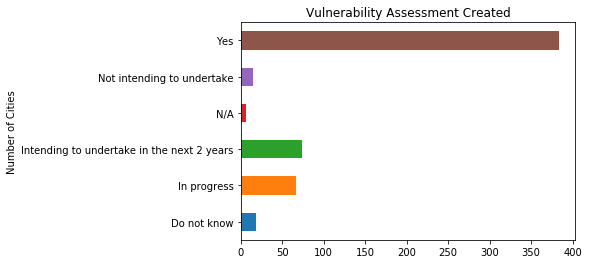

In [79]:
vulassess = resp20[resp20['Question Number']=='2.0']
nanind = vulassess.index[vulassess['Response Answer'].isna()]
vulassess.loc[nanind, 'Response Answer'] = 'N/A'
vulassess.groupby('Response Answer').nunique()['Account Number'].plot.barh()
plt.title('Vulnerability Assessment Created')
plt.ylabel('Number of Cities')

In [73]:
cityemiss = respall[['Year Reported to CDP', 
                     'Account Number', 
                     'Question Number', 
                     'Column Name', 
                     'Row Name', 
                     'Response Answer']]

In [48]:
cityemiss = cityemiss[cityemiss['Question Number']=='4.6a'].dropna(subset=['Response Answer'])

In [49]:
cityemiss.head()

,Year Reported to CDP,Account Number,Question Number,Column Name,Row Name,Response Answer
42,2019,43923,4.6a,"Please explain any excluded sources, identify any emissions covered under an ETS and provide any other comments",Total Transport,"direct an indirect emissions cannot be separated, sum of both was pasted to scope 1"
45,2019,50378,4.6a,"Please explain any excluded sources, identify any emissions covered under an ETS and provide any other comments",Waste > Wastewater,"Las emisiones de aguas residuales incluyen datos de la Planta de Tratamiento de Aguas Residuales Los Tajos, así como datos del Observatorio Municipal sobre la población del cantón y el tipo de vertido o tratamiento de aguas residuales por persona."
64,2019,54113,4.6a,Direct emissions / Scope 1 (metric tonnes CO2e),Total Stationary Energy,220226.29
67,2019,58543,4.6a,"If you have no indirect emissions to report, please select a notation key to explain why",Transportation > Aviation,Not Estimated
123,2019,61790,4.6a,"Please explain any excluded sources, identify any emissions covered under an ETS and provide any other comments",Transportation > Waterborne navigation,Data is difficult to obtain. Efforts should be directed towards changing reporting for this transportation sector.


In [50]:
cityemisstot = cityemiss[(cityemiss['Row Name'] == 'Total Emissions (excluding generation of grid-supplied energy)') |
                         (cityemiss['Row Name'] == 'Total Generation of grid-supplied energy')]

In [51]:
cityemisstot = cityemisstot[cityemisstot['Response Answer'].apply(lambda x: x.isnumeric())]
cityemisstot['Response Answer'] = pd.to_numeric(cityemisstot['Response Answer'])

In [63]:
cityemisstot = cityemisstot.rename(columns={'Year Reported to CDP':'Year Reported', 'Response Answer':'CO2 metric tonnes'})

In [64]:
cityemisstot.loc[cityemisstot['Row Name'] == 'Total Emissions (excluding generation of grid-supplied energy)','Row Name'] = 'Non-grid-energy Applications'
cityemisstot.loc[cityemisstot['Row Name'] == 'Total Generation of grid-supplied energy','Row Name'] = 'From Grid-energy Generation'


In [68]:
cityemisstot = cityemisstot.groupby(['Year Reported', 'Account Number', 'Row Name']).sum()

In [69]:
cityemisstot.head()

CO2 metric tonnes
Year Reported Account Number Row Name                                       
2019          2185           From Grid-energy Generation   0                
              2430           From Grid-energy Generation   0                
                             Non-grid-energy Applications  359615           
              3417           From Grid-energy Generation   12417317         
                             Non-grid-energy Applications  38275608

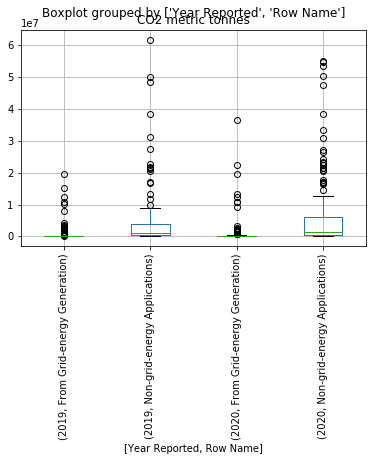

In [71]:
ax=cityemisstot.boxplot(by=['Year Reported', 'Row Name'],rot=90)

In [10]:
cityemisstot.head()

,Year Reported to CDP,Account Number,Question Number,Column Name,Row Name,Response Answer
42,2019,43923,4.6a,"Please explain any excluded sources, identify any emissions covered under an ETS and provide any other comments",Total Transport,"direct an indirect emissions cannot be separated, sum of both was pasted to scope 1"
64,2019,54113,4.6a,Direct emissions / Scope 1 (metric tonnes CO2e),Total Stationary Energy,220226.29
269,2019,36274,4.6a,"If you have no emissions occurring outside the city boundary to report as a result of in-city activities, please select a notation key to explain why",Total Generation of grid-supplied energy,Not Estimated
368,2019,10495,4.6a,"If you have no indirect emissions to report, please select a notation key to explain why",Total AFOLU,Not Estimated
452,2019,834229,4.6a,"Indirect emissions from the use of grid-supplied electricity, heat, steam and/or cooling / Scope 2 (metric tonnes CO2e)",Total Transport,0


In [18]:
cityemiss20 = resp20[resp20['Question Number']=='4.6a'].dropna(subset=['Response Answer'])
cityemiss20 = cityemiss20[cityemiss20['Response Answer'].apply(lambda x: x.isnumeric())]
cityemiss20['Response Answer'] = pd.to_numeric(cityemiss20['Response Answer'])

In [13]:
emiss20sum = cityemiss20.groupby('Row Name').sum().sort_values(by=['Response Answer'], ascending=True)
emiss20sum = emiss20sum[~emiss20sum.index.str.contains('>')]

In [14]:
topemiss = emiss20sum.drop(index='Total Emissions (excluding generation of grid-supplied energy)')

Text(0.5,0,'CO2 Emmission (metric tonnes)')

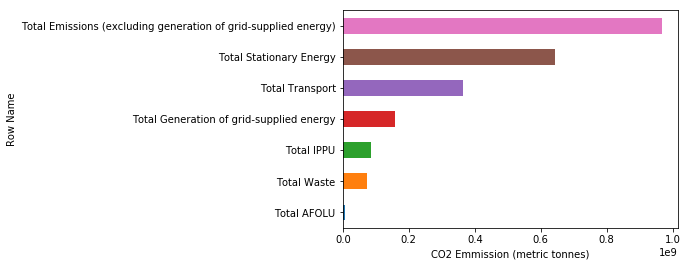

In [17]:
ax = emiss20sum['Response Answer'].plot.barh()
plt.xlabel('CO2 Emmission (metric tonnes)')

In [37]:
yrcount=citiesall[['Year Reported to CDP','Account Number']].groupby('Account Number').count()
yrcount = yrcount.rename(columns={'Year Reported to CDP':'Year Count'})
yrcount = yrcount.reset_index()

In [38]:
filtcond = ((respall['Question Number']=='4.6b') & (respall['Year Reported to CDP']==2019)) |\
((respall['Question Number']=='4.6b') & (respall['Year Reported to CDP']==2020)) |\
((respall['Question Number']=='7.3a') & (respall['Year Reported to CDP']==2018))

cityemiss = respall[filtcond].dropna(subset=['Response Answer'])
cityemiss = cityemiss.merge(yrcount, on='Account Number', suffixes=(None,'_x'))
cityemiss = cityemiss.rename(columns={'Year Reported to CDP':'Year Reported'})
cityemiss = cityemiss[cityemiss['Year Count']>=3]

In [73]:
cityemisssm = cityemiss[['Account Number','Year Reported','Row Name','Response Answer']].dropna(subset=['Response Answer'])
cityemisssm = cityemisssm[cityemisssm['Response Answer'].apply(lambda x: x.isnumeric())]
cityemisssm['Response Answer'] = pd.to_numeric(cityemisssm['Response Answer'])


In [75]:
citiesall[citiesall['Account Number']==3203]

,Year Reported to CDP,Account Number,Organization,City,Country,CDP Region,Reporting Authority,Access,First Time Discloser,Population,Population Year,City Location,Last update
178,2018,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities",public,No,2714017.0,2016,POINT (-87.6298 41.8781),2020-06-25T04:52:49.050
11,2019,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities,ICLEI - Local Governments for Sustainability",public,No,2705994.0,2018,POINT (-87.6298 41.8781),2020-06-25T04:52:51.327
192,2020,3203,City of Chicago,Chicago,United States of America,North America,"C40,CDP Cities,ICLEI - Local Governments for Sustainability",public,No,2705994.0,2018,POINT (-87.6298 41.8781),2020-09-07T09:45:19.793


In [78]:
cityemiss[cityemiss['Account Number']==3203]

,Questionnaire,Year Reported,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update,Year Count
1525,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),2,Stationary Energy: energy use – Scope 2 (I.X.2),14481547,NaN,NaN,24/06/2020 05:28:18 AM,3
1526,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),5,Transportation – Scope 1 (II.X.1),7763715,NaN,NaN,24/06/2020 05:28:18 AM,3
1527,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),16,TOTAL BASIC emissions,32651379,NaN,NaN,24/06/2020 05:28:18 AM,3
1528,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),15,TOTAL Scope 3 emissions,1100599,NaN,NaN,24/06/2020 05:28:18 AM,3
1529,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),3,Stationary Energy: energy use – Scope 3 (I.X.3),0,NaN,NaN,24/06/2020 05:28:18 AM,3
1530,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),7,Transportation – Scope 3 (II.X.3),0,NaN,NaN,24/06/2020 05:28:18 AM,3
1531,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),14,TOTAL Scope 2 emissions,14766295,NaN,NaN,24/06/2020 05:28:18 AM,3
1532,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),12,"Agriculture, Forestry and Land Use – Scope 1 (V)",0,NaN,NaN,24/06/2020 05:28:18 AM,3
1533,CDP Cities 2018,2018,3203,City of Chicago,United States of America,North America,City Wide Emissions,GHG Emissions Data,7.3a,Please provide a summary of emissions by sector and scope as defined in the Global Protocol for Community Greenhouse Gas Emissions Inventories (GPC) in the table below.,1,Emissions (metric tonnes CO2e),4,Stationary Energy: energy generation supplied to the grid – Scope 1 (I.4.4),0,NaN,NaN,24/06/2020 05:28:18 AM,3
1534,CDP Cities 2018,2018,3203,City of Chicago,U

In [ ]:
cityemisssm = cityemisssm.drop(columns=['Account Number']).groupby(['Year Reported','Row Name']).sum()
cityemisssm = cityemisssm.reset_index().pivot(columns='Year Reported',index='Row Name',values='Response Answer')
cityemisssm = cityemisssm.sort_values(by=2020, ascending=False)

In [71]:
cityemisssm=cityemisssm[[2020,2019,2018]]

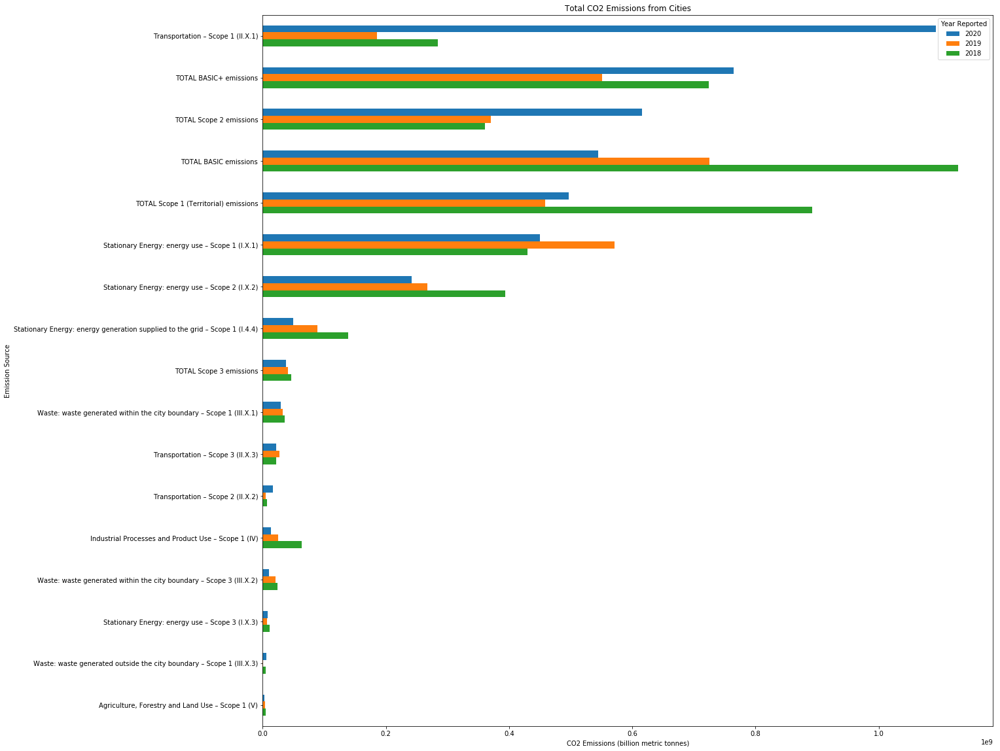

In [72]:
ax=cityemisssm.plot.barh(figsize=(20,20))
plt.title('Total CO2 Emissions from Cities')
plt.ylabel('Emission Source')
plt.xlabel('CO2 Emissions (billion metric tonnes)')
plt.gca().invert_yaxis()

#### World Map

In [105]:
import geopandas
from matplotlib.pyplot import figure
from shapely import wkt

In [82]:
world = geopandas.read_file(geopandas.datasets.get_path('naturalearth_lowres'))

In [104]:
cities20.head()

,Year Reported to CDP,Account Number,Organization,City,Country,CDP Region,Reporting Authority,Access,First Time Discloser,Population,Population Year,City Location,Last update
0,2020,49335,Metropolitan Government of Nashville and Davidson County,Nashville,United States of America,North America,"CDP Cities,ICLEI - Local Governments for Sustainability",public,No,692587.0,2018,POINT (-86.7816 36.1627),2020-09-07T09:45:19.793
1,2020,60278,Prefeitura de Fernandópolis,Fernandópolis,Brazil,Latin America,"CDP Cities,ICLEI - Local Governments for Sustainability",public,No,68823.0,2018,POINT (-50.2475 -20.2858),2020-09-07T09:45:19.793
2,2020,57509,Prefeitura Niterói,Niterói,Brazil,Latin America,"CDP Cities,ICLEI - Local Governments for Sustainability",public,No,513584.0,2019,POINT (-43.1184 -22.8928),2020-09-07T09:45:19.793
3,2020,60114,City of Gdynia,Gdynia,Poland,Europe,"CDP Cities,ICLEI - Local Governments for Sustainability,Union of the Baltic Cities",public,No,246348.0,2019,POINT (18.5305 54.5189),2020-09-07T09:45:19.793
4,2020,32550,City of Denver,Denver,United States of America,North America,"CDP Cities,ICLEI - Local Governments for Sustainability",public,No,716492.0,2018,POINT (-104.985 39.7376),2020-09-07T09:45:19.793


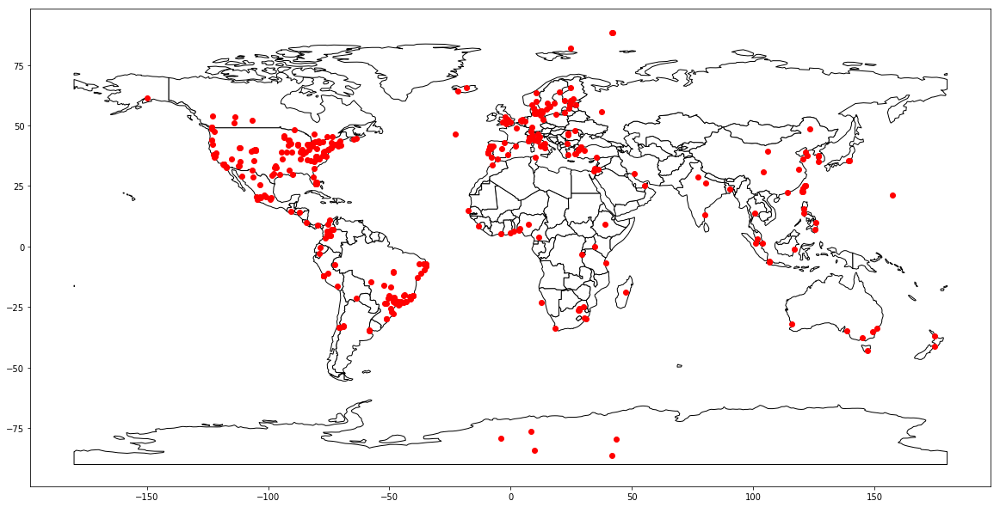

In [122]:
ax = world.plot(color='white', edgecolor='black', figsize=(20,20))
df = cities20[['City','Country','City Location']].dropna(subset=['City Location'])
df['City Location'] = df['City Location'].apply(wkt.loads)
gdf = geopandas.GeoDataFrame(df, geometry='City Location')
gdf.plot(ax=ax, color='red')


### Energy

In [43]:
chic = respall[respall['Account Number']==3203]
chic[chic['Question Number']=='8.0a']

chic['colrow'] = resp19['Question Number']+'-'+resp19['Column Number'].astype(str)+'-'+resp19['Row Number'].astype(str)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


'Response Answer'

In [71]:
renergy = resp19[resp19['Question Number']=='8.0a']
renergy = renergy.dropna(subset=['Response Answer'])
renergy = renergy[renergy['Response Answer'].apply(lambda x: x.isnumeric())]
renergy['Response Answer'] = pd.to_numeric(renergy['Response Answer'])


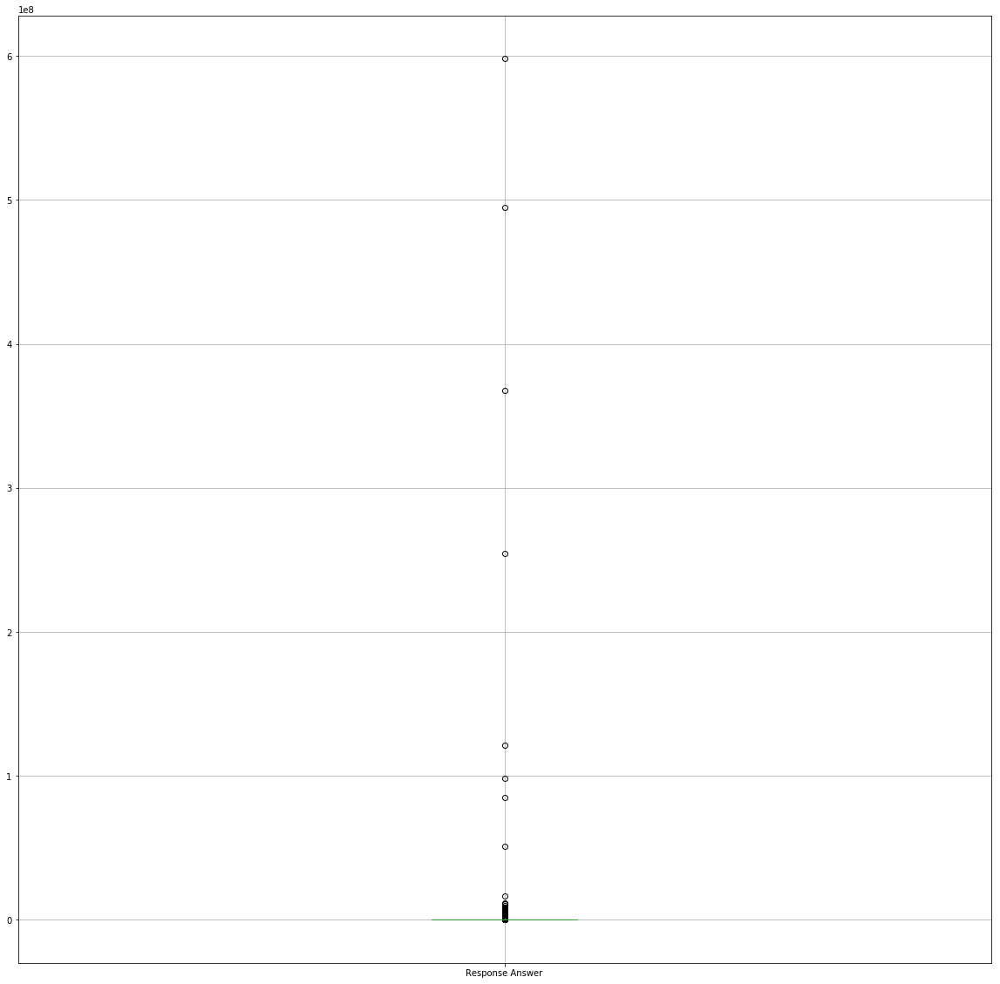

In [73]:
renergy.boxplot(column=['Response Answer'], figsize=(20,20))

In [22]:
filtcond = (resp19['Question Number']=='4.3') & (resp19['Column Number']==1) & (resp19['Row Number']==1)
emProt19 = resp19[filtcond]
emProt19.groupby(['Response Answer']).nunique().sort_values(by=['Account Number'], ascending=False)['Account Number'][0]

308

In [80]:
tesx = '7.0'
pd.to_numeric(lgovEm19['Response Answer']).head()

2067    127828.39
3856    5012.13  
4421    234543.91
6938    724.85   
9887    482.59   
Name: Response Answer, dtype: float64

In [107]:
resp19[resp19['Account Number']==54113].sort_values(by=['Question Number'])

,Questionnaire,Year Reported to CDP,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update
213185,Cities 2019,2019,54113,City of Flagstaff,United States of America,North America,NaN,Introduction,0.1,Please give a general description and introduction to your city including your city’s reporting boundary in the table below.,1,Administrative boundary,1,City boundary,City / Municipality,NaN,NaN,24/06/2020 05:30:36 AM
109411,Cities 2019,2019,54113,City of Flagstaff,United States of America,North America,NaN,Introduction,0.1,Please give a general description and introduction to your city including your city’s reporting boundary in the table below.,2,Description of city,1,City boundary,"Flagstaff is a city located in northern Arizona, in the southwestern United States. For 2018, the city's estimated population was 73,694. The combined metropolitan area of Flagstaff has an estimated population 136,539. It is the county seat of Coconino County, and a regional hub of Northern Arizona. Flagstaff lies near the southwestern edge of the Colorado Plateau, along the western side of the largest contiguous Ponderosa Pine forest in the continental United States. The size of the city is approximately 64 square miles, with an overall density of around 1,030 persons per square mile. Flagstaff enjoys four distinct seasons, in a semi-arid or dry semi-continental climate. Winter temperatures can fall to -10 degrees Fahrenheit and brings an average annual snowfall of 108.8 inches. The average maximum temperature in July is 81.2 degrees Fahrenheit; the average minimum temperature in December is in the teens. Flagstaff has an average of 288 days of sunshine, and 23 inches of precipitation. Ecosystems spanning piñon-juniper studded plateaus, high desert, green alpine forest and barren tundra can all be found within the Flagstaff area. The U.S. Census Bureau estimates the 2018 population for Flagstaff to be 73,964. This represents a 11% increase from the 2010 estimate. According to the 2010 Census, the average household size in Flagstaff is 2.61 persons; the median age is 26.8 years, with 20.6% of the population under 18 and 6.4% of the population 65 years of age or older. The poverty rate in Flagstaff is 24%, and the 2018 estimated median household income is $51,758. Originally called Kinlani by the Dine (Navajo), the area around Flagstaff has been inhabited for thousands of years. Evidence of the earliest native cultures in the Flagstaff area can be found in the cliff dwellings of Walnut Canyon National Monument and the rock-walled pueblos of Wupatki National Monument, where the ancient Sinagua and Anasazi tribes inhabited more than 800 years ago. The racial and ethnic makeup of Flagstaff citizens today is as follows: 64% white, 18% Hispanic or Latino. 12% American Indian or Alaskan Native, 2% Asian, 2% black, and 4% multi-racial. Today, many members of the Navajo and Hopi tribes live in and around Flagstaff. Regionally, the City of Flagstaff with the Economic Collaborative of Northern Arizona (ECoNA), defines the region as the I-40 corridor from Williams to Winslow and Verde Valley to the Navajo Reservation. This geographic area is responsible for the majority of Northern Arizona businesses, residents and investments. Located in the center of Northern Arizona’s trade region, Flagstaff enjoys a dramatic increase in inbound workforce, shoppers, students and residents from surrounding communities all supporting our local and regional economy. Flagstaff’s main employer is Northern Arizona University, which educates 23,000 students in Flagstaff. Flagstaff is also a medical hub with the Flagstaff Medical Center; other top employers include W.L. Gore, the Flagstaff Unified School District, Coconino County, the City of Flagstaff, and Wal-Mart. Tourism is a large part of the Flagstaff economy, due to the proximity to Grand Can

In [105]:
allacc = resp19['Account Number'].unique()
q76acc = lgovEm19['Account Number'].unique()
bq76 = [anum for anum in allacc if anum not in q76acc]

bq76[0]
        

54113

In [111]:

# Local Government Emissions
filtcond = (resp19['Question Number']=='7.6') & (resp19['Column Number']==1) & (resp19['Row Number']==1)
lgovEm19 = resp19[filtcond].dropna(subset=['Response Answer'])
lgovEm19['Response Answer'] = pd.to_numeric(lgovEm19['Response Answer'])
lgovEm19['Response Answer'].describe()

#cityemisssm['Response Answer'] = pd.to_numeric(cityemisssm['Response Answer'])

count    3.150000e+02
mean     7.809539e+05
std      4.387788e+06
min      3.530000e+00
25%      6.599105e+03
50%      3.230800e+04
75%      1.539484e+05
max      6.382178e+07
Name: Response Answer, dtype: float64

In [136]:
18 in range(1,18)

False

In [156]:
citygovem19 = filtq(resp19,['4.6b'],[1],range(1,18))
pivCEm19 = citygovem19.pivot(values='Response Answer',columns='Row Name',index='Account Number')

In [163]:
pivCEm19[pivCEm19.index==3203].head()

Row Name,"Agriculture, Forestry and Land Use – Scope 1 (V)",Industrial Processes and Product Use – Scope 1 (IV),Stationary Energy: energy generation supplied to the grid – Scope 1 (I.4.4),Stationary Energy: energy use – Scope 1 (I.X.1),Stationary Energy: energy use – Scope 2 (I.X.2),Stationary Energy: energy use – Scope 3 (I.X.3),TOTAL BASIC emissions,TOTAL BASIC+ emissions,TOTAL Scope 1 (Territorial) emissions,TOTAL Scope 2 emissions,TOTAL Scope 3 emissions,Transportation – Scope 1 (II.X.1),Transportation – Scope 2 (II.X.2),Transportation – Scope 3 (II.X.3),Waste: waste generated outside the city boundary – Scope 1 (III.X.3),Waste: waste generated within the city boundary – Scope 1 (III.X.1),Waste: waste generated within the city boundary – Scope 3 (III.X.2)
Account Number,,,,,,,,,,,,,,,,,
3203,0,0,NaN,9018535,14481547,0,32651379,45374422,16784486,14766295,1100599,7763715,284748,0,0,2235,1100599


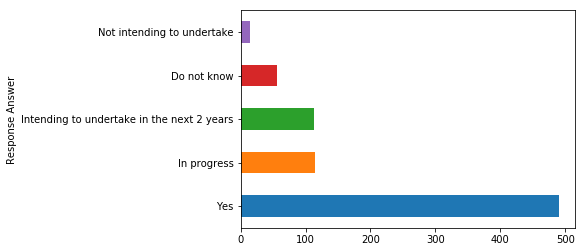

In [12]:
resp19[resp19['Question Number']=='2.0'].groupby('Response Answer').count().sort_values(by=['Account Number'], ascending=False)['Account Number'].plot.barh()

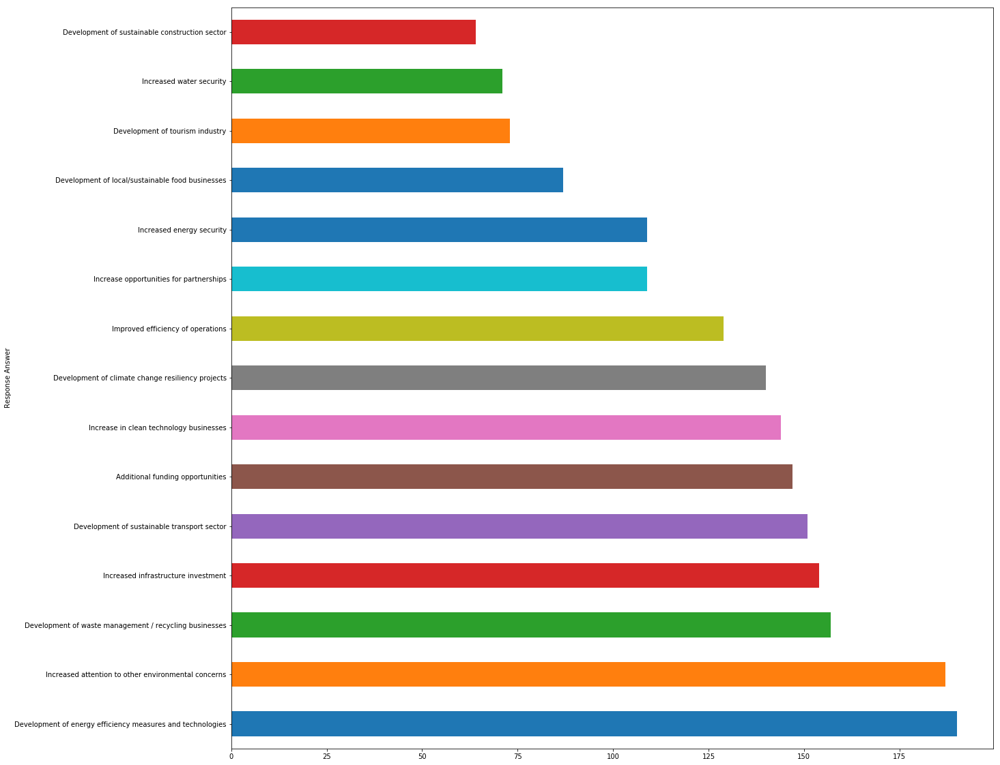

In [18]:
resp19[(resp19['Question Number']=='6.0') & (resp19['Column Number']==1)].groupby(['Response Answer']).count().sort_values(by=['Account Number'], ascending=False)['Account Number'][0:15].plot.barh(figsize=(20,20))

In [21]:
tempdf = resp19[(resp19['Account Number']==3203) & (resp19['Question Number']=='2.0b')]
pivind = pd.MultiIndex.from_tuples(list(zip(tempdf['Account Number'],tempdf['Row Number'])), names=['Account Number', 'Row Number'])
tempdf['Pivot Index'] = pivind
tempdf.pivot(index='Pivot Index', columns='Column Name',values='Response Answer')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Column Name,Areas/sectors covered by the risk and vulnerability assessment,Boundary of assessment relative to city boundary (reported in 0.1),Does the assessment identify vulnerable populations?,Explanation of boundary choice where the assessment boundary differs from the city boundary,Primary author of assessment,Publication title and attach the document,Web link,Year of adoption from local government
Pivot Index,,,,,,,,
"(3203, 1)",NaN,Same – covers entire city and nothing else,Yes,The assessment covers the City of Chicago,Other: Academic researchers,Climate Change and Chicago: Projections and Potential Impacts,http://www.chicagoclimateaction.org/pages/research___reports/8.php,2008


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Text(0.5,0,'Number of Cities')

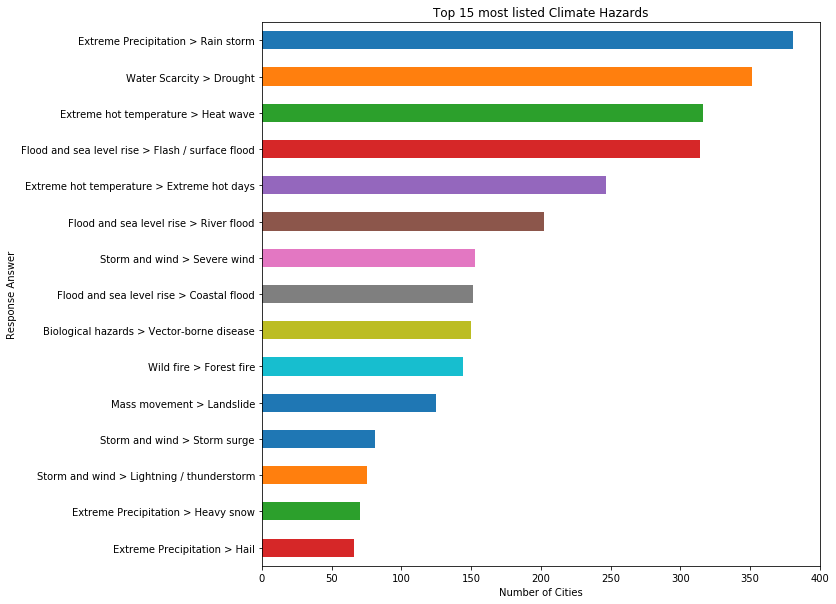

In [95]:
# hazards
tempdf = resp19[(resp19['Question Number']=='2.1') & (resp19['Column Number']==1)]
pivind = pd.MultiIndex.from_tuples(list(zip(tempdf['Account Number'],tempdf['Row Number'])), names=['Account Number', 'Row Number'])
tempdf['Pivot Index'] = pivind
tempdf = tempdf.groupby('Response Answer').count().sort_values(by=['Account Number'],ascending=False)['Account Number'].head(15)
tophaz = tempdf.index
tempdf.plot.barh(figsize=(10,10))
plt.gca().invert_yaxis()
plt.title('Top 15 most listed Climate Hazards')
plt.xlabel('Number of Cities')

In [127]:
tempdf2['Total']=tempdf2.sum(axis=1)
tempdf2.head()

Current probability of hazard,High,Medium High,Medium,Medium Low,Low,Does not currently impact the city,Do not know,Total
Climate Hazards,,,,,,,,
Biological hazards > Air-borne disease,4.0,7.0,4.0,4.0,5.0,NaN,3.0,27.0
Biological hazards > Insect infestation,15.0,9.0,11.0,5.0,7.0,NaN,2.0,49.0
Biological hazards > Vector-borne disease,33.0,27.0,50.0,21.0,14.0,1.0,3.0,149.0
Biological hazards > Water-borne disease,11.0,10.0,14.0,4.0,6.0,NaN,1.0,46.0
Chemical change > Atmospheric CO2 concentrations,20.0,12.0,11.0,4.0,1.0,NaN,4.0,52.0


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



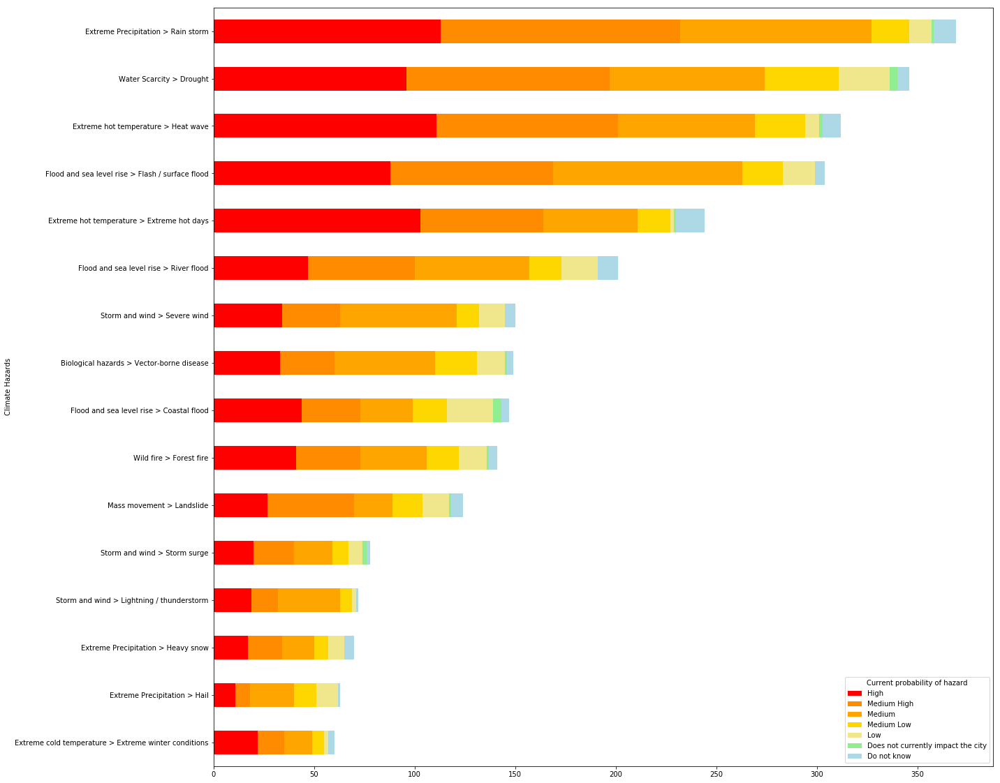

In [132]:
tempdf2 = resp19[(resp19['Question Number']=='2.1') & ((resp19['Column Number']==1) | (resp19['Column Number']==3))]
pivind = pd.MultiIndex.from_tuples(list(zip(tempdf2['Account Number'],tempdf2['Row Number'])), names=['Account Number', 'Row Number'])
tempdf2['Pivot Index'] = pivind
tempdf2 = tempdf2.pivot(values='Response Answer',columns='Column Name',index='Pivot Index')
tempdf2 = tempdf2.reset_index().groupby(['Climate Hazards','Current probability of hazard']).count().reset_index()
tempdf2 = tempdf2.pivot(values='Pivot Index',index='Climate Hazards',columns='Current probability of hazard')
tempdf2 = tempdf2[['High','Medium High','Medium','Medium Low','Low','Does not currently impact the city','Do not know']]
tempdf2['Total']=tempdf2.sum(axis=1)
tempdf2 = tempdf2.sort_values(by='Total', ascending=False).head(16).drop(columns=['Total'])
tophaz = tempdf2.columns
tempdf2.plot.barh(stacked=True, figsize=(20,20), color=['red','darkorange','orange','gold','khaki','lightgreen','lightblue'])
plt.gca().invert_yaxis()

In [66]:
# hazards listed
tempdf = resp19[(resp19['Question Number']=='2.1')\
                & (resp19['Column Number']==1)]
tempdf = tempdf[tempdf['Response Answer'].apply(lambda x: x in tophaz)]
# specific population affected by hazard
tempdf2 = resp19[(resp19['Question Number']=='2.1')\
       & ((resp19['Column Number']==10))]

pivind = list(zip(tempdf['Account Number'],tempdf['Row Number']))
pivind2 = list(zip(tempdf2['Account Number'],tempdf2['Row Number']))
tempdf['Pivot Index'] = pivind
tempdf2['Pivot Index'] = pivind2

topcols = tempdf2.groupby('Response Answer').count().sort_values(by=['Account Number'],ascending=False).head(16).index
tempdf2 = tempdf2.pivot(values='Account Number',index='Pivot Index',columns='Response Answer')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [67]:
tempdf3 = tempdf.merge(tempdf2[topcols].notna().reset_index(), left_on='Pivot Index', right_on='Pivot Index',\
          suffixes=('_left', '_right'))
tempdf3 = tempdf3.groupby('Response Answer').sum()[topcols]
tempdf4 = tempdf3.reset_index().melt(id_vars=['Response Answer'])

In [68]:
import plotly.graph_objects as go

In [69]:
all_nodes = tempdf4['Response Answer'].values.tolist() + tempdf4['variable'].values.tolist()
source_indices = [all_nodes.index(haz) for haz in tempdf4['Response Answer']]
target_indices = [all_nodes.index(affpop) for affpop in tempdf4['variable']]

fig = go.Figure(data=[go.Sankey(
    node = dict(
      pad = 20,
      thickness = 20,
      line = dict(color = "black", width = 1.0),
      label =  all_nodes,
    ),

    link = dict(
      source =  source_indices,
      target =  target_indices,
      value =  tempdf4.value,
))])

fig.update_layout(title_text="Popluations Affected by Climate Hazards",
                  font_size=10)
fig.show()

### Adaptions

In [5]:
adap19 = filtq(resp19, '3.0', [1,2,8,10], list(range(1000)))
pivind = pd.MultiIndex.from_tuples(list(zip(adap19['Account Number'],adap19['Row Number'])), names=['Account Number', 'Row Number'])
adap19['Pivot Index'] = pivind
adap19 = adap19.pivot(values='Response Answer',columns='Column Name', index='Pivot Index')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Text(0.5,0,'Projects Funded')

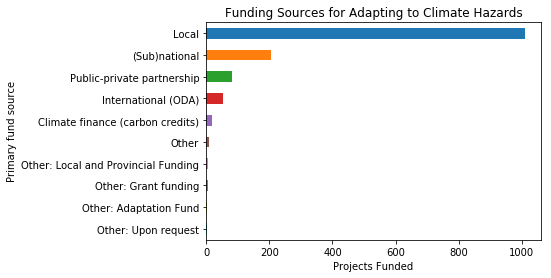

In [30]:
adap19.reset_index().groupby('Primary fund source').count().sort_values(by=['Pivot Index'], ascending=False).head(10)['Pivot Index'].plot.barh()
plt.gca().invert_yaxis()
plt.title('Funding Sources for Adapting to Climate Hazards')
plt.xlabel('Projects Funded')


Text(0.5,0,'Number of times listed')

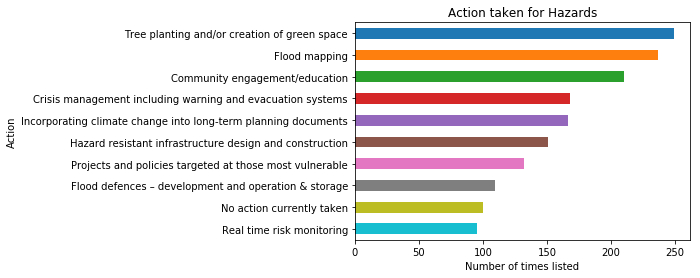

In [59]:
adact19 = adap19.reset_index().groupby('Action').count().sort_values(by=['Pivot Index'], ascending=False).head(10)['Pivot Index']
adact19.plot.barh()
plt.gca().invert_yaxis()
plt.title('Action taken for Hazards')
plt.xlabel('Number of times listed')

Text(0,0.5,'Action')

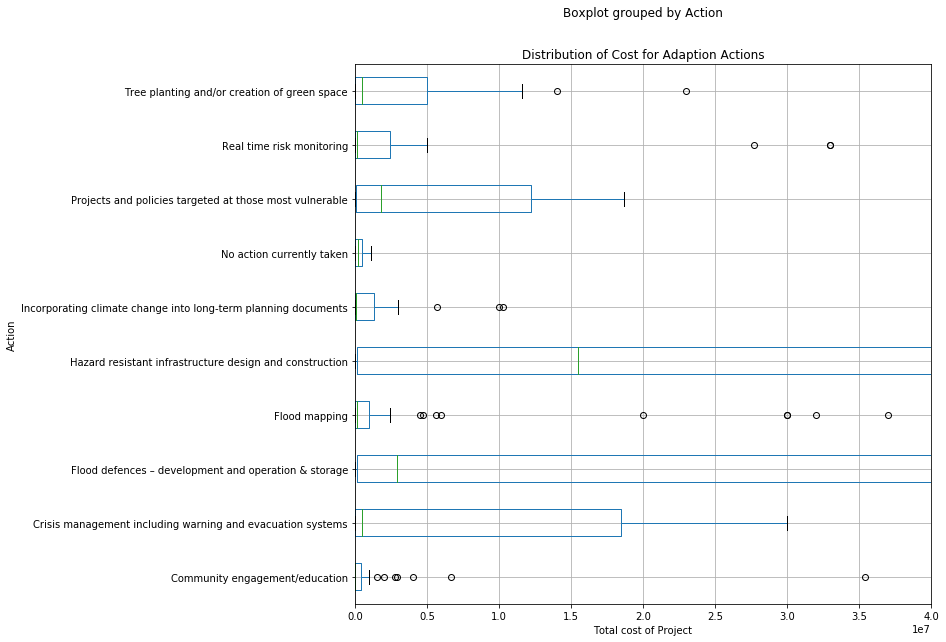

In [79]:
topact19 = adact19.index
adcost19 = adap19[['Action', 'Total cost of the project']].dropna().reset_index().drop(columns=['Pivot Index'])
adcost19 = adcost19[adcost19['Action'].apply(lambda x: x in topact19)]
adcost19['Total cost of the project'] = pd.to_numeric(adcost19['Total cost of the project'])
adcost19.boxplot(by='Action',vert=False,figsize=(10,10))
plt.xlim([-1,0.4e8])
plt.title('Distribution of Cost for Adaption Actions')
plt.xlabel('Total cost of Project')
plt.ylabel('Action')

In [160]:
adplan19.groupby('Response Answer').count()\
.sort_values(by=['Account Number'],ascending=False)\
.head(10)['Account Number']\

Response Answer
Adaptation is covered in the city plans               5
Lack of resources / funding                           4
Adaptation is not currently a priority for my city    3
Lack of political will                                3
Adaptation is covered under main city strategy        2
Lack of expertise                                     2
Other                                                 1
Name: Account Number, dtype: int64

Text(0.5,1,'Reasons for not creating adaptions plans')

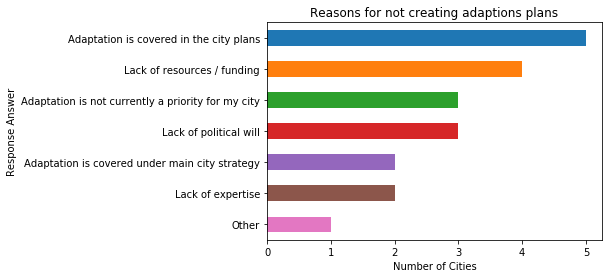

In [87]:
adplan19 = filtq(resp19, '3.1b',[1],[1])
adplan19.groupby('Response Answer').count()\
.sort_values(by=['Account Number'],ascending=False)\
.head(10)['Account Number']\
.plot.barh()

plt.gca().invert_yaxis()
plt.xlabel('Number of Cities')
plt.title('Reasons for not creating adaptions plans')

About 24 cities did not create dedicated climate action plans. Disregarding cities which incorporated adaption into overall city plans, it would be worthwhile to tackle the underlying causes for the other issues. For example, to address lack of expertise cities can enlist the help of their neighbors.

In [95]:
adgoal19 = filtq(resp19, '3.2',range(6), range(1000))

In [96]:
pivind = pd.MultiIndex.from_tuples(list(zip(adgoal19['Account Number'],adgoal19['Row Number'])), names=['Account Number', 'Row Number'])
adgoal19['Pivot Index'] = pivind
adgoal19 = adgoal19.pivot(values='Response Answer',columns='Column Name', index='Pivot Index')


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [100]:
adgoal19.shape

(1769, 5)

In [184]:
adaff.head()

Column Name,Factors that affect ability to adapt,Please describe the factor and the degree to which it supports or challenges the adaptive capacity of your city,Support / Challenge
Pivot Index,,,
"(1093, 1)",Rapid urbanization,"Both the City and region have experienced significant growth over the last decade. The city’s population increased by 12 percent from 2010 to 2016, reaching 473,000 in 2016. This increase is slightly higher than that of the 29-county Metropolitan Statistical Area (MSA), which grew 10 percent over the same time period.1 Net domestic in-migration has played a major role in the City’s population growth as more millennials and middle income Americans move to lower cost Sun Belt cities like Atlanta.2 The Atlanta Regional Commission estimates that by 2040 the wider 20-county Atlanta region will add 2.5 million people and 1 million jobs, increasing from 5.6 million to 8.0 million people and from 2.9 million to 3.9 million jobs. Atlanta is among the most ethnically integrated cities in the U.S. Data released by the Pew Research Center indicates that 78 counties nationwide experienced a switch in majorityminority population since 2000 and four of these counties are located in the Atlanta region.4 The city’s recent population growth, however, has spurred changing demographic changes. From 2000-2016 the percentage of city residents who identify as either White or Asian increased by 7 percentage points and the percentage of African American residents decreased by 9 percentage points. Furthermore, the region remains largely divided along racial lines with the White population clustered in the north and the Black population clustered in the south. With this rapid population growth, coupled with expanding income inequality and numerous high-end real estate investments, Metro Atlanta is at risk of becoming an increasingly divided region – racially, socially, and geographically. Atlanta’s vibrant culture and history and its role in the Civil Rights movement are two of its most unifying traits; yet, if these qualities are not preserved and strengthened, the city could lose part of its tangible heritage. There is a need now more than ever to empower residents to strengthen community roots, preserve Atlanta’s history, and embrace a shared, multigenerational identity",Challenge
"(1184, 1)",Public health,"Low-income communities of color with limited access to healthcare may face adaptation challenges related to air quality, extreme heat, flooding, and other climate-related public health hazards.",Challenge
"(1499, 1)",Access to basic services,Barcelona is a compact and mixed city. The 96% of its population lives less than 300 m from 3 basic services.,Support
"(2028, 1)",Budgetary capacity,NaN,Challenge
"(2430, 1)",Housing,"60% of Burlington's housing stock is rental property, and the majority of Burlington's housing stock is old and would benefit from weatherization and energy efficiency upgrades. Old buildings do not withstand intense rain events and heat waves, both of which will likely become more frequent. Because of Burlington's low vacancy rate, property owners are not motivated to invest in their buildings, resulting in a ""split incentive"".",Challenge


In [213]:
# factors affecting adaption
adaff = filtq(resp19,'2.2',[1,2,3],[1])
pivind = pd.MultiIndex.from_tuples(list(zip(adaff['Account Number'],adaff['Row Number'])), names=['Account Number', 'Row Number'])
adaff['Pivot Index'] = pivind
adaff = adaff.pivot(values='Response Answer',columns='Column Name', index='Pivot Index')

adaff = adaff.reset_index()\
.groupby(['Factors that affect ability to adapt','Support / Challenge'])\
.count()\
.reset_index()[['Factors that affect ability to adapt','Pivot Index','Support / Challenge']]
adaff['Factors that affect ability to adapt'] = adaff['Factors that affect ability to adapt'].apply(lambda x: x[0:70])


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


In [214]:
adaff = adaff.pivot(index='Factors that affect ability to adapt',values='Pivot Index', columns='Support / Challenge')\
.fillna(0)
adaff=adaff[['Support','Challenge']]

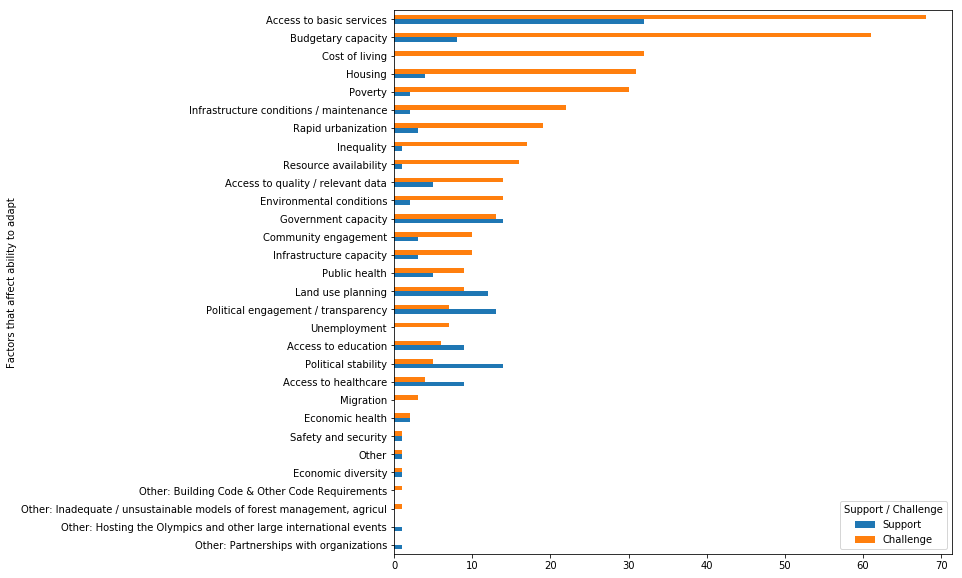

In [215]:
adaff.sort_values(by='Challenge')\
.plot.barh(figsize=(10,10))


Cities listed the above factors as an issue or strength in adapting to climate hazards. 'Access to basic services' was listed about 100 times. About 30 cities have adequate access to basic services and have listed them as a support adapting to climate change. 70 cities still need bolstering of basic services and studying the strategy of the aformentioned 30 could reveal insights to address this challenge. <br>
<br>
Budgetary capacity was almost always listed as a challenge suggesting more funds are needed for adaption plans.

In [190]:
# factors affecting adaption
adaff = filtq(resp19,'2.2',[1,2,3],[1])
pivind = pd.MultiIndex.from_tuples(list(zip(adaff['Account Number'],adaff['Row Number'])), names=['Account Number', 'Row Number'])
adaff['Pivot Index'] = pivind
adaff = adaff.pivot(values='Response Answer',columns='Column Name', index='Pivot Index')

adaff = adaff[adaff['Support / Challenge']=='Support'].reset_index()\
.groupby('Factors that affect ability to adapt')\
.count()\
.reset_index()[['Factors that affect ability to adapt','Pivot Index']]
adaff['Factors that affect ability to adapt'] = adaff['Factors that affect ability to adapt'].apply(lambda x: x[0:70])


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


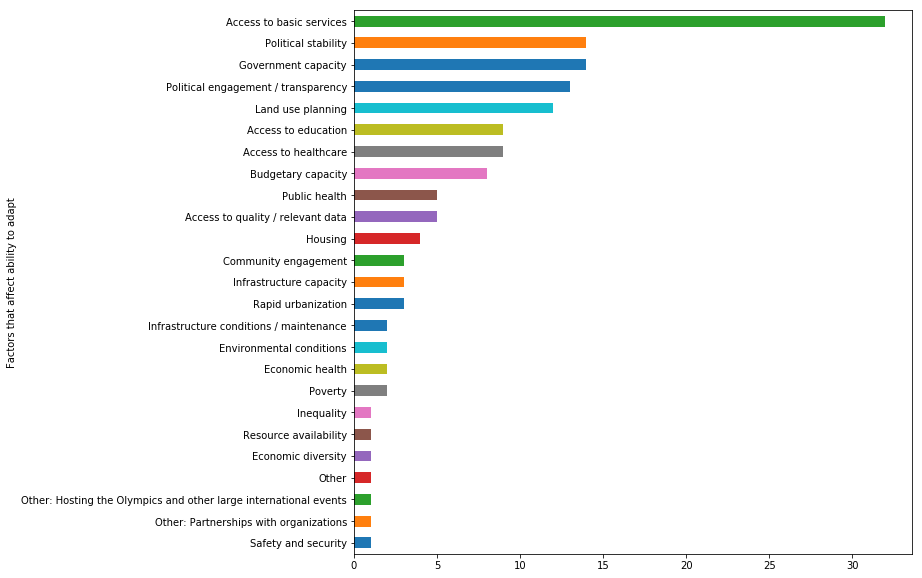

In [191]:
adaff.set_index('Factors that affect ability to adapt')\
.sort_values(by='Pivot Index')['Pivot Index']\
.plot.barh(figsize=(10,10))

### Energy

In [52]:
teststr = 'All electricity consumed (in MWh)'
testlist = renpiv['Energy / electricity types covered by target'].str.extract(r"\((.*?)\)$", expand=False)
renpiv[renpiv['Units'].isna()]

Column Name,Base year,Energy / electricity types covered by target,Percentage of target achieved,Percentage renewable energy / electricity of total energy or electricity in base year,Percentage renewable energy / electricity of total energy or electricity in target year,Plans to meet target (include details on types of energy/electricity),Scale,Target year,Total renewable energy / electricity covered by target in base year (in unit specified in column 2),Total renewable energy / electricity covered by target in target year (in unit specified in column 2),Units
Pivot Index,,,,,,,,,,,
"(3422, 2)",1990,"Other: Zero carbon rail operations, under City control",NaN,NaN,100,NaN,Local government operations,2030,NaN,NaN,NaN
"(8242, 1)",1990,NaN,NaN,NaN,20,"City of Helsinki targets, Helen Ltd development plan",City-wide,2020,NaN,NaN,NaN
"(31009, 0)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(31117, 1)",1990,Other: 75% of community-wide energy,17,NaN,75,"1. Advancement on Community Energy Planning: maximize the potential for Community Energy Planning preparation and implementation for all new major developments and revitalization areas, exploring net-zero CEPs whenever possible2. Advance low-energy/renewable district energy networks: significantly scale up the development of thermal energy networks and map low carbon/renewable energy sources across Toronto3. Create a renewable energy strategy: Advance the city-wide adoption of clean, renewable energy technologies such as solar PV, wind and geo-exchange through a comprehensive long term strategy developed with industry stakeholders.",City-wide,2050,NaN,NaN,NaN
"(31146, 1)",NaN,Other,NaN,NaN,NaN,"There are three energy offices that are overseen by the Ministry of Water, Irrigation and Electricity (MoWIE), and which are playing a role in the electricity delivery value-chain. These offices are the Ethiopian Energy Authority (EEA), Ethiopian Electric Power (EEP) and Ethiopian Electric Utility (EEU). EEA is an energy sector regulator. EEP is responsible for generation, transmission and system operation, and EEU responsible for power distribution. There is no city institution responsible for managing or mandating the supply and distribution of grid electricity in Addis Ababa, as it is all managed at the federal level. However, in AA, the electricity is a composite of hydroelectricity, geothermal and wind-energy, which has almost no emissions, so in terms of emission reduction potential, decarbonising AA’s electricity supply will have little impact on total emissions in the city. Even if the likely rates of growth and demand for energy may require additional generation capacity from higher carbon sources, the federal government’s implementing sustainable energy for all (SE4ALL) which is a National Action Plan that aimed at energy diversification through the installation of geothermal power plants, wind farms and solar systems.",City-wide,NaN,NaN,NaN,NaN
"(31153, 1)",NaN,NaN,NaN,NaN,48,"In addition to the more intensive use of efficient and low-emission CHP and district heating, Berlin has a variety of possibilities for using renewables: in order to exploit the urban solar potential, a “masterplan” will be set up which bundles the various measures. The urban electricity grid can absorb large additional quantities of solar power so that, together with rising CHP output, Berlin has the prospect of becoming self-sufficient. By additionally expanding heat pumps and other uses of surplus renewable energy (Power-to-X, P2X), excess solar power and excess wind power from the hinterland can be utilised. A number of “smart” flexibility measures, i.e. controlled by information and communications technologies (ICT), will be implemented. The P2X applications, those which convert electricity into e.g. a different storable source of energy, are primarily located in the city because they can be well integrated into the electricity, heat and gas network and there are sufficient customers.",City-wide,2050,59541

In [70]:

renergy = filtq(resp19,['8.0a'],range(11),range(100))
pivind = pd.MultiIndex.from_tuples(list(zip(renergy['Account Number'],renergy['Row Number'])), names=['Account Number', 'Row Number'])
renergy['Pivot Index'] = pivind

renpiv = renergy.pivot(values='Response Answer',index='Pivot Index',columns='Column Name')
renpiv['Units'] = renpiv['Energy / electricity types covered by target'].str.extract(r"\((.*?)\)$", expand=False)
renpiv = renpiv.dropna(subset=['Units'])
#renpiv = renpiv[renpiv['Units'].str.lower().str.contains('mw')]
renpiv = renpiv.reset_index()
renpiv['Account Number'] = renpiv['Pivot Index'].apply(lambda x: x[0])

#renergy.groupby('Account Number').count().sort_values(by='Row Number', ascending=False).head()
renpiv['Account Number'].nunique()


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


224

In [74]:
ensource = filtq(resp19, ['8.2'],range(10),range(100))
ensource = ensource.pivot(index='Account Number',values='Response Answer',columns='Column Name')

(318, 9)

In [81]:
carb0 = filtq(resp19, ['8.4'], range(100), range(100))
carb0 = carb0[['Account Number','Response Answer']].dropna(subset=[''])

82

### Buildings

In [98]:
buildemm = filtq(resp19, ['9.0'],range(100),range(100))
buildemm['Row Name'] = buildemm['Row Name'] + ' (' + buildemm['Column Name'] + ')'
buildemm = buildemm.pivot(values='Response Answer',columns='Row Name',index='Account Number')
builden = filtq(resp19, ['9.4'],range(100),range(100))
builden['Row Name'] = builden['Row Name'] + ' (' + builden['Column Name'] + ')'
builden = builden.pivot(values='Response Answer', columns='Row Name', index='Account Number')
buildmet = buildemm.join(builden, how='outer')
builden.shape

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


(82, 6)

### Transport

In [121]:
passtrans = filtq(resp19, ['10.1'],range(100), range(100))
passtrans['Column Name'] = 'Passenger - ' + passtrans['Column Name']
passtrans = passtrans.pivot(values='Response Answer', columns='Column Name', index='Account Number')
freighttrans =  filtq(resp19, ['10.2'],range(100), range(100))
freighttrans['Row Name'] = 'Freight - ' + freighttrans['Row Name']
#freighttrans = freighttrans.pivot(values='Response Answer', columns='Row Name', index='Account Number')
transall = passtrans.join(freighttrans, how='outer')
transall.head()
resp19[(resp19['Account Number']==3203)].sort_values(by='Question Number')

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


,Questionnaire,Year Reported to CDP,Account Number,Organization,Country,CDP Region,Parent Section,Section,Question Number,Question Name,Column Number,Column Name,Row Number,Row Name,Response Answer,Comments,File Name,Last update
245037,Cities 2019,2019,3203,City of Chicago,United States of America,North America,NaN,Introduction,0.1,Please give a general description and introduction to your city including your city’s reporting boundary in the table below.,1,Administrative boundary,1,City boundary,City / Municipality,NaN,NaN,24/06/2020 05:30:36 AM
282582,Cities 2019,2019,3203,City of Chicago,United States of America,North America,NaN,Introduction,0.1,Please give a general description and introduction to your city including your city’s reporting boundary in the table below.,2,Description of city,1,City boundary,"With a land area of 606.1 km2, Chicago is the third most populous city in the United States and consistently ranks among the top 10 global cities in leading indices - including recent publications by IBM, the Economist Intelligence Unit, and A.T. Kearney. Bounded by Lake Michigan to its east and residential, industrial, and agrarian lands to its north, west, and south, Chicago is an international hub for finance, commerce, industry, technology, communications, and transportation. Today, Chicago is one of the world’s greenest and most livable cities, thanks to strong partnerships between government, residents, and businesses – we’re pioneering some of the greatest innovations in sustainability today from reducing the “urban heat island effect” to offering an extensive low-cost energy-efficient public transit system to transforming our streets to make it the most bike friendly city in the nation. The past 15 years have also seen tremendous growth in our understanding of climate change and the important role that cities can play in addressing it. This worldwide threat to our planet demands an encompassing plan from every city, state, and nation and action from every resident and business to reduce emissions of heat trapping gases and ensure a good quality of life for future generations. Building on a legacy of energy efficiency and public transit leadership, the City of Chicago strives to continue developing new approaches to ensure that sustainable transportation and energy options are available to all residents and businesses. Our efforts hold enormous potential to further address economic challenges and promote growing opportunities.",NaN,NaN,24/06/2020 05:30:36 AM
332700,Cities 2019,2019,3203,City of Chicago,United States of America,North America,NaN,Introduction,0.2,"If you have not previously submitted your Letter of Commitment to the Global Covenant of Mayors, either through the relevant regional covenant or through the Global Covenant secretariat, please attach the letter signed by an appropriately mandated official (e.g. Mayor, City Council) to this question.",0,NaN,0,NaN,NaN,NaN,NaN,24/06/2020 05:30:36 AM
314340,Cities 2019,2019,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,Please provide information about your city’s Mayor or equivalent legal representative authority in the table below:,1,Leader title,1,Please complete,Mayor,NaN,NaN,24/06/2020 05:30:36 AM
328833,Cities 2019,2019,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,Please provide information about your city’s Mayor or equivalent legal representative authority in the table below:,3,Current term end month,1,Please complete,May,NaN,NaN,24/06/2020 05:30:36 AM
379429,Cities 2019,2019,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,Please provide information about your city’s Mayor or equivalent legal representative authority in the table below:,2,Leader name,1,Please complete,Lori Lightfoot,NaN,NaN,24/06/2020 05:30:36 AM
53376,Cities 2019,2019,3203,City of Chicago,United States of America,North America,Introduction,City Details,0.3,

### Consolidated

In [174]:
# compile data at city level
# emissions, emission reduction, energy, oppurtunity, buildings, transport, waste

# getting city population and area
filtdf = filtq(resp19, ['0.5', '0.6'], [1,3],[1])
citycompile = filtdf.pivot(values='Response Answer', columns='Column Name', index='Account Number')
citycompile = citycompile.rename(columns={"Land area of the city boundary as defined in question 0.1 (in square km)":"Land Area (sq km)"})
citycompile = citycompile.apply(pd.to_numeric)

# getting climate if vulnerability report made
filtdf = filtq(resp19, ['2.0'], [0],[0])
pivdf = filtdf.pivot(values='Response Answer', columns='Row Name', index='Account Number')
pivdf.columns = ['Risk Vulnerability Assessment']
citycompile = citycompile.join(pivdf, how='outer')

# getting emissions, CO2 metric tonnes from different scopes
filtdf = filtq(resp19, ['4.6b'],[1], range(100))
pivdf = filtdf.pivot(values='Response Answer', columns='Row Name', index='Account Number')
pivdf = pivdf.apply(pd.to_numeric)
citycompile = citycompile.join(pivdf, how='outer')

# getting emiision reduction targets, %target and % achievedd
filtdf = filtq(resp19, ['5.0a'], [1,7,10], range(100))
filtdf['pivind'] = index = pd.MultiIndex.from_frame(filtdf[['Account Number','Row Number']])
pivdf = filtdf.pivot(values='Response Answer', columns='Column Name', index='pivind')
pivdf = pivdf[pivdf.Sector=='All emissions sources included in city inventory']
pivdf = pivdf.reset_index()
pivdf['Account Number'] = pivdf.pivind.apply(lambda x: x[0])
pivdf = pivdf.set_index('Account Number')[['Percentage of target achieved so far', 'Percentage reduction target']]
pivdf.columns = ['Emission Reduction Achieved (%)', 'Emission Reduction Target (%)']
pivdf = pivdf.apply(pd.to_numeric)
citycompile = citycompile.join(pivdf, how='outer')

# getting energy data, renewable target exists and percentage of different sources
filtdf = filtq(resp19, ['8.0'], [0], [0])
pivdf = filtdf.pivot(values='Response Answer', columns='Column Name', index='Account Number')
pivdf.columns = ['Renewable Target Exists']
citycompile = citycompile.join(pivdf, how='outer')

filtdf = filtq(resp19, ['8.0a'], [5], range(20))
filtdf['Response Answer'] = pd.to_numeric(filtdf['Response Answer'])
filtdf = filtdf.groupby(['Account Number', 'Column Name']).max()['Response Answer']
filtdf = filtdf.reset_index(level='Column Name', drop=True).fillna(0)
citycompile = citycompile.join(filtdf, how='outer')
citycompile = citycompile.rename(columns={'Response Answer':'Renewable Energy (%)'})

# getting oppurtinity data, ESG in investing, business collab, established funds,
# green growth strategy, development bank funding, green jobs
filtdf = filtq(resp19, ['6.1','6.3','6.4','6.6','6.9','6.11'],[0],[0])
pivdf = filtdf.pivot(values='Response Answer', columns='Question Name', index='Account Number')
pivdf = pivdf.rename(columns={'How many people within your City are employed in green jobs/ industries?':'Green Jobs'})
pivdf['Green Jobs'] = pd.to_numeric(pivdf['Green Jobs'])
citycompile = citycompile.join(pivdf, how='outer')

# getting buildings data, CO2 from different buildings
filtdf = filtq(resp19, ['9.0'], [1],range(10))
pivdf = filtdf.pivot(values='Response Answer', columns='Row Name', index='Account Number')
pivdf = pivdf.rename(columns={'Municipal' : 'Municipal Buildings', 
                              'Commercial':'Commerical Buildings',
                             'Residential': 'Residential Buildings'})
pivdf.columns = [colname+' (CO2 Tonnes per capita)' for colname in pivdf.columns]
pivdf = pivdf.apply(pd.to_numeric)
citycompile = citycompile.join(pivdf, how='outer')

# getting transportation data, % of different transport modes
filtdf = filtq(resp19, ['10.1'], range(10),range(10))
pivdf = filtdf.pivot(values='Response Answer', columns='Column Name', index='Account Number').fillna(0)
pivdf = pivdf.apply(pd.to_numeric)
citycompile = citycompile.join(pivdf, how='outer')

# getting waste data, waste per capita
filtdf = filtq(resp19, ['13.0'], [1],[2])
pivdf = filtdf.pivot(values='Response Answer', columns='Row Name', index='Account Number')
pivdf = pivdf.apply(pd.to_numeric)
pivdf2 = pivdf
citycompile = citycompile.join(pivdf, how='outer')



C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [189]:
# imputing categorical column NA values with no
citycompile.loc[:,citycompile.dtypes=='object'] = citycompile.loc[:,citycompile.dtypes=='object'].fillna('No').replace('Do not know', 'No')

# imputing base population with mean
citycompile['Current population'] = citycompile['Current population'].fillna(citycompile['Current population'].mean())

# dividing emission data and green jobscolumns with base year population
stdcolumns=['Agriculture, Forestry and Land Use – Scope 1 (V)',
           'Industrial Processes and Product Use – Scope 1 (IV)',
           'Stationary Energy: energy generation supplied to the grid – Scope 1 (I.4.4)',
           'Stationary Energy: energy use – Scope 1 (I.X.1)',
           'Stationary Energy: energy use – Scope 2 (I.X.2)',
           'Stationary Energy: energy use – Scope 3 (I.X.3)',
           'TOTAL BASIC emissions', 'TOTAL BASIC+ emissions',
           'TOTAL Scope 1 (Territorial) emissions', 'TOTAL Scope 2 emissions',
           'TOTAL Scope 3 emissions', 'Transportation – Scope 1 (II.X.1)',
           'Transportation – Scope 2 (II.X.2)',
           'Transportation – Scope 3 (II.X.3)',
           'Waste: waste generated outside the city boundary – Scope 1 (III.X.3)',
           'Waste: waste generated within the city boundary – Scope 1 (III.X.1)',
           'Waste: waste generated within the city boundary – Scope 3 (III.X.2)',
           'Green Jobs']

citycompile[stdcolumns] = citycompile[stdcolumns].div(citycompile['Current population'],axis=0)

citycompile.drop(columns = ['Current population','Land Area (sq km)', 'Projected population'], inplace=True)

# imputing emission columns with mean
impmncols = ['Agriculture, Forestry and Land Use – Scope 1 (V)',
               'Industrial Processes and Product Use – Scope 1 (IV)',
               'Stationary Energy: energy generation supplied to the grid – Scope 1 (I.4.4)',
               'Stationary Energy: energy use – Scope 1 (I.X.1)',
               'Stationary Energy: energy use – Scope 2 (I.X.2)',
               'Stationary Energy: energy use – Scope 3 (I.X.3)',
               'TOTAL BASIC emissions', 'TOTAL BASIC+ emissions',
               'TOTAL Scope 1 (Territorial) emissions', 'TOTAL Scope 2 emissions',
               'TOTAL Scope 3 emissions', 'Transportation – Scope 1 (II.X.1)',
               'Transportation – Scope 2 (II.X.2)',
               'Transportation – Scope 3 (II.X.3)',
               'Waste: waste generated outside the city boundary – Scope 1 (III.X.3)',
               'Waste: waste generated within the city boundary – Scope 1 (III.X.1)',
               'Waste: waste generated within the city boundary – Scope 3 (III.X.2)',
               'Emission Reduction Target (%)',
               'All building types (CO2 Tonnes per capita)',
               'Commerical Buildings (CO2 Tonnes per capita)',
               'Municipal Buildings (CO2 Tonnes per capita)',
               'Residential Buildings (CO2 Tonnes per capita)',
               'Buses (including BRT)', 
               'Cycling', 
               'Ferries/ River boats', 
               'Other',
               'Private motorized transport', 
               'Rail/Metro/Tram',
               'Taxis or For Hire Vehicles', 
               'Walking',
               'Waste generation per capita (kg/person/year)'
             ]

citycompile[impmncols] = citycompile[impmncols].fillna(citycompile[impmncols].mean())

# imputing 0 for na values
imp0cols = ['Green Jobs',
            'New buildings (CO2 Tonnes per capita)',
            'Emission Reduction Achieved (%)',
            'Renewable Energy (%)'            
           ]
citycompile[imp0cols] = citycompile[imp0cols].fillna(0)

In [190]:
citycompile.select_dtypes(include='object')

,Risk Vulnerability Assessment,Renewable Target Exists,"Are Environmental, Social and Governance (ESG) issues incorporated into investment decisions of any of the city retirement funds?",Does your city collaborate in voluntary partnership with businesses in your city on sustainability projects?,"Has your City established a fund to invest in energy efficiency, renewable energy or carbon reduction projects?",Has your City prepared a strategy for green growth?,"Has your City received/secured funding for any low carbon projects (e.g. energy efficiency, renewable energy, low emission vehicles, bus rapid transit, waste management) or climate adaptation projects from a development bank (e.g. World Bank, Asian Development Bank, etc.)?"
Account Number,,,,,,,
1093,Yes,Yes,No,Yes,No,No,No
1184,Yes,Yes,No,Yes,Yes,Yes,No
1499,Yes,Yes,No,Yes,No,Yes,No
2028,Yes,No,No,No,No,No,No
2185,In progress,Yes,No,Yes,No,No,No
2430,Intending to undertake in the next 2 years,Yes,No,Yes,No,No,No
3203,Yes,Yes,No,Yes,No,Yes,No
3417,Yes,Yes,Yes,Yes,Yes,Yes,No
3417,Yes,Yes,Yes,Yes,Yes,Yes,No


In [206]:
citycatvars = citycompile.select_dtypes(include='object')
catcols = citycatvars.columns
# define the k-modes model
km = KModes(n_clusters=5, init='Huang', n_init=11)
# fit the clusters to the skills dataframe
clusters = km.fit_predict(citycatvars)
# get an array of cluster modes
kmodes = km.cluster_centroids_
shape = kmodes.shape

In [225]:
citycatvars = citycompile.select_dtypes(include='object')
catcols = citycatvars.columns
cost = []
for num_clusters in list(range(1,6)):
    kmode = KModes(n_clusters=num_clusters, init = "Cao", n_init = 1)
    kmode.fit_predict(citycatvars)
    cost.append(kmode.cost_)

Text(0,0.5,'Cost')

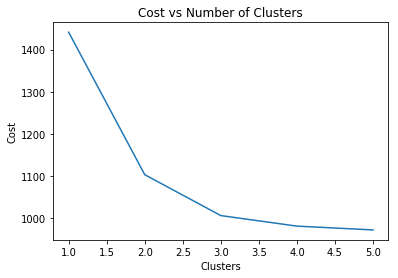

In [226]:
y = np.array([i for i in range(1,6,1)])
plt.plot(y,cost)
plt.title('Cost vs Number of Clusters')
plt.xlabel('Clusters')
plt.ylabel('Cost')

In [208]:
kmodes

array([['In progress', 'No', 'No', 'Yes', 'No', 'No', 'No'],
       ['Yes', 'Yes', 'No', 'Yes', 'No', 'No', 'No'],
       ['Yes', 'In progress', 'No', 'Yes', 'No', 'No', 'No'],
       ['Yes', 'No', 'No', 'No', 'No', 'No', 'No'],
       ['Yes', 'Yes', 'Yes', 'Yes', 'Yes', 'Yes', 'No']], dtype='<U11')

In [209]:
citycompile.select_dtypes(include='object').shape

(910, 7)

In [221]:
citynumvars = citycompile.select_dtypes(exclude='object')
scaler = StandardScaler()
scaled_features = scaler.fit_transform(citynumvars)

In [223]:
kmeans_kwargs = {"init": "random",
                 "n_init": 10,
                 "max_iter": 300,
                 "random_state": 42,
                }
# finding appropriate number of clusters
sse = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(scaled_features)
    sse.append(kmeans.inertia_)

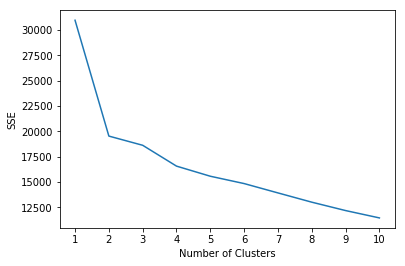

In [224]:
plt.plot(range(1, 11), sse)
plt.xticks(range(1, 11))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

In [232]:
kl = KneeLocator(range(1, 11), sse, curve="convex", direction="decreasing")
kl.elbow

2

In [227]:
pd.DataFrame(kmeans.cluster_centers_, columns=citynumvars.columns)

,"Agriculture, Forestry and Land Use – Scope 1 (V)",Industrial Processes and Product Use – Scope 1 (IV),Stationary Energy: energy generation supplied to the grid – Scope 1 (I.4.4),Stationary Energy: energy use – Scope 1 (I.X.1),Stationary Energy: energy use – Scope 2 (I.X.2),Stationary Energy: energy use – Scope 3 (I.X.3),TOTAL BASIC emissions,TOTAL BASIC+ emissions,TOTAL Scope 1 (Territorial) emissions,TOTAL Scope 2 emissions,TOTAL Scope 3 emissions,Transportation – Scope 1 (II.X.1),Transportation – Scope 2 (II.X.2),Transportation – Scope 3 (II.X.3),Waste: waste generated outside the city boundary – Scope 1 (III.X.3),Waste: waste generated within the city boundary – Scope 1 (III.X.1),Waste: waste generated within the city boundary – Scope 3 (III.X.2),Emission Reduction Achieved (%),Emission Reduction Target (%),Renewable Energy (%),Green Jobs,All building types (CO2 Tonnes per capita),Commerical Buildings (CO2 Tonnes per capita),Municipal Buildings (CO2 Tonnes per capita),New buildings (CO2 Tonnes per capita),Residential Buildings (CO2 Tonnes per capita),Buses (including BRT),Cycling,Ferries/ River boats,Other,Private motorized transport,Rail/Metro/Tram,Taxis or For Hire Vehicles,Walking,Waste generation per capita (kg/person/year)
0,0.028080,-2.841033e-02,-3.090435e-02,-3.286661e-02,-0.029740,-0.027746,-2.948226e-02,-2.564359e-02,-3.132975e-02,-2.802365e-02,-2.941175e-02,-2.990177e-02,-2.732711e-02,-5.022897e-03,-0.026478,-2.935835e-02,-4.141547e-02,-0.263236,0.025661,-0.231742,-0.062078,-1.511160e-02,-2.376528e-02,-0.051434,0.0,-2.698526e-02,4.794788e-02,-2.822618e-03,-1.691059e-02,0.025735,-3.210720e-02,-1.484701e-01,3.288623e-02,-3.206871e-02,-2.345585e-02
1,0.000000,2.990450e+01,1.113811e+01,4.544363e+00,29.966578,29.997641,3.005973e+01,2.965103e+01,3.002996e+01,3.000693e+01,2.991187e+01,3.006634e+01,3.002203e+01,2.225947e+01,29.737349,2.993073e+01,1.332758e-16,-0.380059,-0.538554,-0.311493,-0.080795,1.034326e-15,-5.930748e-16,0.000000,0.0,-5.319302e-16,1.755897e-16,-1.243179e-16,4.875718e-17,0.000000,-3.738941e-16,-3.172985e-16,-1.159424e-16,-2.003455e-16,7.632879e-17
2,-0.228197,-6.015080e-02,-1.060596e-01,-7.097253e-02,-0.062118,-0.067485,-5.343786e-02,-7.557453e-02,-5.517087e-02,-6.523383e-02,-4.340334e-02,-5.389654e-02,-6.972611e-02,-1.289329e-01,-0.064155,-8.103051e-02,4.978440e-01,2.546121,-0.334608,0.179309,0.269951,2.527317e-02,7.803315e-03,-0.203046,0.0,-3.023715e-02,-2.405479e-01,-2.430147e-02,-9.086149e-02,-0.145723,8.171017e-02,1.445856e+00,-2.814090e-01,2.416026e-01,-1.118984e-01
3,0.000000,-6.271263e-17,-5.886721e-17,3.854109e-17,0.000000,0.000000,3.674908e-17,1.302582e-16,-9.722373e-17,5.561869e-17,4.884276e-17,2.830926e-17,4.130120e-17,-4.476716e-16,0.000000,-4.986063e-17,1.332758e-16,-0.380059,0.000000,-0.311493,-0.080653,2.258563e+01,2.608523e+01,0.000000,0.0,2.926871e+01,1.916909e+00,2.559710e-01,-1.701803e-01,0.018307,5.256930e-01,-8.525797e-01,4.457916e-01,-1.370107e+00,-3.771429e-01
4,0.000000,-6.271263e-17,-5.886721e-17,3.854109e-17,0.000000,0.000000,3.674908e-17,1.302582e-16,-9.722373e-17,5.561869e-17,4.884276e-17,2.830926e-17,4.130120e-17,-4.476716e-16,0.000000,-4.986063e-17,1.332758e-16,-0.380059,0.000000,1.797657,-0.078836,-3.034432e+00,-7.580333e-01,17.843139,0.0,-7.739632e-02,-1.108835e+00,9.978094e-01,2.442309e+01,0.153609,-2.005373e+00,-6.739565e-01,8.028079e-02,-2.422626e-01,-3.768240e-01
5,-0.052328,-5.130305e-02,-1.051633e-01,-5.891544e-02,-0.056003,-0.052286,-5.363244e-02,-7.094924e-02,-4.615685e-02,-5.752483e-02,-6.414955e-02,-4.427668e-02,-6.162040e-02,-1.433545e-01,-0.086222,-5.826624e-02,-1.767553e-01,-0.026650,0.161572,4.271544,-0.067280,-2.765563e-01,-1.749978e-01,1.077616,0.0,-1.479886e-01,-5.118148e-01,7.892679e-02,-8.302135e-02,-0.218061,5.334336e-01,-3.050544e-02,-1.556272e-01,2.003680e-01,-4.376146e-02
6,0.000000,-3.612308e-01,-5.127616e-01,3.854109e-17,-0.209854,-0.326139,-1.688782e-01,-2.731001e-01,-1.716137e-01,-2.232341e-01,-3.440800e-01,-1.246979e-01,-2.657436e-01,-1.08

### Corporations - Climate Disclosure

In [13]:
corpclimd18 = pd.read_csv('../data/Corporations/Corporations Disclosing/Climate Change/2018_Corporates_Disclosing_to_CDP_Climate_Change.csv')
corpclimd19 = pd.read_csv('../data/Corporations/Corporations Disclosing/Climate Change/2019_Corporates_Disclosing_to_CDP_Climate_Change.csv')
corpclimd20 = pd.read_csv('../data/Corporations/Corporations Disclosing/Climate Change/2020_Corporates_Disclosing_to_CDP_Climate_Change.csv')

In [46]:
corpclimd20[corpclimd20['account_number']==14683]

,account_number,organization,survey_year,country,region,invitation_status,public,samples,response_received_date,minimum_tier,selected_tier,questionnaire,theme,authority_types,activities,sectors,industries,primary_activity,primary_sector,primary_industry,primary_questionnaire_sector,primary_ticker,tickers
590,14683,Pfizer Inc.,2020,United States of America,NaN,Submitted,public,"Benchmark, CCGR1800, Continuity Climate Change, FTSE All-World, Global 500, MSCI ACWI, S&P 500",2020-08-26T22:21:12Z,Climate Change - Full,Climate Change - Full,Climate Change 2020,Climate Change,"Investor, Supply Chain",Pharmaceuticals,Biotech & pharma,"Biotech, health care & pharma",Pharmaceuticals,Biotech & pharma,"Biotech, health care & pharma",General,PFE US,PFE US


### Corporations - Climate Response

In [22]:
corpclimr18 = pd.read_csv('../data/Corporations/Corporations Responses/Climate Change/2018_Full_Climate_Change_Dataset.csv')
corpclimr19 = pd.read_csv('../data/Corporations/Corporations Responses/Climate Change/2019_Full_Climate_Change_Dataset.csv')
corpclimr20 = pd.read_csv('../data/Corporations/Corporations Responses/Climate Change/2020_Full_Climate_Change_Dataset.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2785: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [39]:
corpclimr20[corpclimr20['account_number']==14683]

,account_number,organization,survey_year,response_received_date,accounting_period_to,ors_response_id,submission_date,page_name,module_name,question_number,question_unique_reference,column_number,column_name,table_columns_unique_reference,row_number,row_name,data_point_name,data_point_id,response_value,comments
373031,14683,Pfizer Inc.,2020,2020-08-26T22:21:12Z,NaN,106554,2020-08-27T03:22:54Z,C6.5,C6. Emissions data,C6.5,"Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions.",3.0,C6.5_C3Emissions calculation methodology,C6.5_c3-Emissions calculation methodology,8,Upstream leased assets,"C6.5_C3_Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions. - Emissions calculation methodology",280,Leased facility square footage for sites not within Pfizer's operational control derived from Pfizer's corporate real estate database. Emissions estimated using the Greenhouse Gas Protocol/Quantis Scope 3 Evaluator.,NaN
373032,14683,Pfizer Inc.,2020,2020-08-26T22:21:12Z,NaN,106554,2020-08-27T03:22:54Z,C6.5,C6. Emissions data,C6.5,"Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions.",4.0,C6.5_C4Percentage of emissions calculated using data obtained from suppliers or value chain partners,C6.5_c4-Percentage of emissions calculated using data obtained from suppliers or value chain partners,7,Employee commuting,"C6.5_C4_Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions. - Percentage of emissions calculated using data obtained from suppliers or value chain partners",281,100.0,NaN
373033,14683,Pfizer Inc.,2020,2020-08-26T22:21:12Z,NaN,106554,2020-08-27T03:22:54Z,C6.5,C6. Emissions data,C6.5,"Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions.",4.0,C6.5_C4Percentage of emissions calculated using data obtained from suppliers or value chain partners,C6.5_c4-Percentage of emissions calculated using data obtained from suppliers or value chain partners,8,Upstream leased assets,"C6.5_C4_Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions. - Percentage of emissions calculated using data obtained from suppliers or value chain partners",281,100.0,NaN
373034,14683,Pfizer Inc.,2020,2020-08-26T22:21:12Z,NaN,106554,2020-08-27T03:22:54Z,C6.5,C6. Emissions data,C6.5,"Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions.",4.0,C6.5_C4Percentage of emissions calculated using data obtained from suppliers or value chain partners,C6.5_c4-Percentage of emissions calculated using data obtained from suppliers or value chain partners,17,Other (downstream),"C6.5_C4_Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions. - Percentage of emissions calculated using data obtained from suppliers or value chain partners",281,NaN,NaN
373035,14683,Pfizer Inc.,2020,2020-08-26T22:21:12Z,NaN,106554,2020-08-27T03:22:54Z,C6.5,C6. Emissions data,C6.5,"Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions.",5.0,C6.5_C5Please explain,C6.5_c5-Please explain,10,Processing of sold products,"C6.5_C5_Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions. - Please explain",282,Pfizer products are not further processed in significant quantities.,NaN
373036,14683,Pfizer Inc.,2020,2020-08-26T22:21:12Z,NaN,106554,2020-08-27T03:22:54Z,C6.5,C6. Emissions data,C6.5,"Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusions.",5.0,C6.5_C5Please explain,C6.5_c5-Please explain,12,End of life treatment of sold products,"C6.5_C5_Account for your organizationâ€™s gross global Scope 3 emissions, disclosing and explaining any exclusi

### Corporations - Water Security Disclosure

In [27]:
corpwaterd18 = pd.read_csv('../data/Corporations/Corporations Disclosing/Water Security/2018_Corporates_Disclosing_to_CDP_Water_Security.csv')
corpwaterd19 = pd.read_csv('../data/Corporations/Corporations Disclosing/Water Security/2019_Corporates_Disclosing_to_CDP_Water_Security.csv')
corpwaterd20 = pd.read_csv('../data/Corporations/Corporations Disclosing/Water Security/2020_Corporates_Disclosing_to_CDP_Water_Security.csv')


In [30]:
corpwaterd20.head()

,account_number,organization,survey_year,country,region,invitation_status,public,samples,response_received_date,minimum_tier,selected_tier,questionnaire,theme,authority_types,activities,sectors,industries,primary_activity,primary_sector,primary_industry,primary_questionnaire_sector,primary_ticker,tickers
0,64106,Arconic Corp,2020,United States of America,NaN,Submitted,public,"Continuity Water, Water Global",2020-08-21T19:40:22Z,Water - Full,Water - Full,Water Security 2020,Water,"Investor, Supply Chain","Aluminium refining, Aluminum, Engines & motor...","Metal products manufacturing, Metal smelting,...","Manufacturing, Materials",Other vehicle equipment & systems,Powered machinery,Manufacturing,General,ARNC US,ARNC US
1,2407,Bunge,2020,United States of America,NaN,Submitted,public,"Continuity Water, Water Global",2020-08-26T16:57:52Z,Water - Full,Water - Full,Water Security 2020,Water,"Investor, Supply Chain","Agricultural products wholesale, Food & bever...","Chemicals, Food & beverage processing, Tradin...","Food, beverage & agriculture, Materials, Retail",Agricultural products wholesale,"Trading, wholesale, distribution, rental & lea...",Retail,Agricultural commodities,BG US,BG US
2,2802,Cargill,2020,United States of America,NaN,Submitted,public,"Continuity Water, Water Global",2020-08-24T20:21:07Z,Water - Full,Water - Full,Water Security 2020,Water,"Investor, Supply Chain","Animal processing, Food & beverage wholesale,...","Food & beverage processing, Trading, wholesal...","Food, beverage & agriculture, Retail",Sugar,Food & beverage processing,"Food, beverage & agriculture",Agricultural commodities,3091Z US,3091Z US
3,3876,Ingredion Incorporated,2020,United States of America,NaN,Submitted,public,"Continuity Water, Water Global",2020-08-26T00:05:22Z,Water - Full,Water - Full,Water Security 2020,Water,"Investor, Supply Chain",Grain & corn milling,Food & beverage processing,"Food, beverage & agriculture",Grain & corn milling,Food & beverage processing,"Food, beverage & agriculture","Food, beverage & tobacco",INGR US,INGR US
4,9336,International Flavors & Fragrances Inc.,2020,United States of America,NaN,Submitted,public,"Continuity Water, Water Global",2020-08-26T20:58:21Z,Water - Full,Water - Full,Water Security 2020,Water,"Investor, Supply Chain",Specialty chemicals,Chemicals,Materials,Specialty chemicals,Chemicals,Materials,Chemicals,IFF US,IFF US


### Corporations - Water Security Response

In [28]:
corpwaterr18 = pd.read_csv('../data/Corporations/Corporations Responses/Water Security/2018_Full_Water_Security_Dataset.csv')
corpwaterr19 = pd.read_csv('../data/Corporations/Corporations Responses/Water Security/2019_Full_Water_Security_Dataset.csv')
corpwaterr20 = pd.read_csv('../data/Corporations/Corporations Responses/Water Security/2020_Full_Water_Security_Dataset.csv')


C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:2785: DtypeWarning: Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [32]:
corpwaterr20.head()

,account_number,organization,survey_year,response_received_date,accounting_period_to,ors_response_id,submission_date,page_name,module_name,question_number,question_unique_reference,column_number,column_name,table_columns_unique_reference,row_number,row_name,data_point_name,data_point_id,response_value,comments
0,64106,Arconic Corp,2020,2020-08-21T19:40:22Z,NaN,84366,2020-08-21T19:50:28Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,2.0,W1.2h_C2Volume (megaliters/year),W1.2h_c2-Volume (megaliters/year),5,Produced/Entrained water,W1.2h_C2_Provide total water withdrawal data b...,1277,NaN,NaN
1,64106,Arconic Corp,2020,2020-08-21T19:40:22Z,NaN,84366,2020-08-21T19:50:28Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,3.0,W1.2h_C3Comparison with previous reporting year,W1.2h_c3-Comparison with previous reporting year,3,Groundwater â€“ renewable,W1.2h_C3_Provide total water withdrawal data b...,1278,About the same,NaN
2,64106,Arconic Corp,2020,2020-08-21T19:40:22Z,NaN,84366,2020-08-21T19:50:28Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,3.0,W1.2h_C3Comparison with previous reporting year,W1.2h_c3-Comparison with previous reporting year,6,Third party sources,W1.2h_C3_Provide total water withdrawal data b...,1278,Higher,NaN
3,64106,Arconic Corp,2020,2020-08-21T19:40:22Z,NaN,84366,2020-08-21T19:50:28Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,4.0,W1.2h_C4Please explain,W1.2h_c4-Please explain,2,Brackish surface water/Seawater,W1.2h_C4_Provide total water withdrawal data b...,1279,NaN,NaN
4,64106,Arconic Corp,2020,2020-08-21T19:40:22Z,NaN,84366,2020-08-21T19:50:28Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,4.0,W1.2h_C4Please explain,W1.2h_c4-Please explain,6,Third party sources,W1.2h_C4_Provide total water withdrawal data b...,1279,3.8% volume increase due to the addition of th...,NaN


In [33]:
corpwaterr20[corpwaterr20['account_number']==14683]

,account_number,organization,survey_year,response_received_date,accounting_period_to,ors_response_id,submission_date,page_name,module_name,question_number,question_unique_reference,column_number,column_name,table_columns_unique_reference,row_number,row_name,data_point_name,data_point_id,response_value,comments
64295,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W4.2a,W4. Risks and opportunities,W4.2a,Provide details of risks identified within you...,3.0,W4.2a_C3Type of risk & Primary risk driver_G,W4.2a_c3-Type of risk & Primary risk driver_G,1,NaN,W4.2a_C3_Provide details of risks identified w...,8126,Reputation & markets,NaN
64296,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W4.2,W4. Risks and opportunities,W4.2,Provide details of identified risks in your di...,1.0,W4.2_C1Country/Area & River basin_G,W4.2_c1-Country/Area & River basin_G,1,NaN,W4.2_C1_Provide details of identified risks in...,1343,Saudi Arabia,NaN
64297,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W4.2a,W4. Risks and opportunities,W4.2a,Provide details of risks identified within you...,14.0,W4.2a_C14Primary response to risk_G,W4.2a_c14-Primary response to risk_G,1,NaN,W4.2a_C14_Provide details of risks identified ...,8634,Direct operations,NaN
64298,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W-MM3.2,W3. Procedures,W-MM3.2,"By river basin, what number of active and inac...",1.0,W-MM3.2_C1Country/Area & River basin_G,W-MM3.2_c1-Country/Area & River basin_G,0,NaN,"W-MM3.2_C1_By river basin, what number of acti...",8327,NaN,NaN
64299,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W4.1c,W4. Risks and opportunities,W4.1c,"By river basin, what is the number and proport...",1.0,W4.1c_C1Country/Area & River basin_G,W4.1c_c1-Country/Area & River basin_G,1,NaN,"W4.1c_C1_By river basin, what is the number an...",1333,Saudi Arabia,NaN
64300,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W4.2a,W4. Risks and opportunities,W4.2a,Provide details of risks identified within you...,1.0,W4.2a_C1Country/Area & River basin_G,W4.2a_c1-Country/Area & River basin_G,1,NaN,W4.2a_C1_Provide details of risks identified w...,1354,India,NaN
64301,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W5.1,W5. Facility-level water accounting,W5.1,"For each facility referenced in W4.1c, provide...",3.0,W5.1_C3Country/Area & River basin_G,W5.1_c3-Country/Area & River basin_G,1,NaN,"W5.1_C3_For each facility referenced in W4.1c,...",1382,Saudi Arabia,NaN
64302,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W4.2,W4. Risks and opportunities,W4.2,Provide details of identified risks in your di...,2.0,W4.2_C2Type of risk & Primary risk driver_G,W4.2_c2-Type of risk & Primary risk driver_G,1,NaN,W4.2_C2_Provide details of identified risks in...,1344,Physical,NaN
64303,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,2.0,W1.2h_C2Volume (megaliters/year),W1.2h_c2-Volume (megaliters/year),6,Third party sources,W1.2h_C2_Provide total water withdrawal data b...,1277,9690.0,NaN
64304,14683,Pfizer Inc.,2020,2020-08-26T12:08:03Z,NaN,106556,2020-08-26T13:54:52Z,W1.2h,W1. Current state,W1.2h,Provide total water withdrawal data by source.,4.0,W1.2h_C4Please explain,W1.2h_c4-Please explain,2,Brackish surface water/Seawater,W1.2h_C4_Provide total water withdrawal data b...,1279,Pfizer implemented improvements in 2016 which ...,NaN


## Analysis<a class="anchor" id="analysis"></a>

## Summary Statistics

641 cities responded in 2018. 861 in 2019 and 566 in 2020.
